# Load packages, data, and models

In [1]:
import pickle
import train
import build_features
import numpy as np
import pandas as pd
import time
import os
import zscore
from scipy import stats
import matplotlib.pyplot as plt
from sklearn import metrics
from dateutil.relativedelta import relativedelta
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

/Volumes/CPO/ObesityPY/src/train.py:12: UserWarning: 
This call to matplotlib.use() has no effect because the backend has already
been chosen; matplotlib.use() must be called *before* pylab, matplotlib.pyplot,
or matplotlib.backends is imported for the first time.

The backend was *originally* set to 'module://ipykernel.pylab.backend_inline' by the following code:
  File "/Users/hammor01/anaconda3/lib/python3.6/runpy.py", line 193, in _run_module_as_main
    "__main__", mod_spec)
  File "/Users/hammor01/anaconda3/lib/python3.6/runpy.py", line 85, in _run_code
    exec(code, run_globals)
  File "/Users/hammor01/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py", line 16, in <module>
    app.launch_new_instance()
  File "/Users/hammor01/anaconda3/lib/python3.6/site-packages/traitlets/config/application.py", line 658, in launch_instance
    app.start()
  File "/Users/hammor01/anaconda3/lib/python3.6/site-packages/ipykernel/kernelapp.py", line 486, in start
    self.io_loop.start

In [2]:
d1 = pickle.load(open('../python objects/patientdata_20170823.pkl', 'rb'))

maternal = np.load('../outputs_age_analyses20180221/maternal_24months.npz')
x1 = maternal['x']
y1 = maternal['y']
y1label = maternal['ylabel']
mrns = maternal['mrns']
feature_headers = maternal['features']

g_wfl = np.loadtxt('../auxdata/WHO_wfl_girls_p_exp.txt', delimiter='\t')
b_wfl = np.loadtxt('../auxdata/WHO_wfl_boys_p_exp.txt', delimiter='\t')

boys_maternal_no_exclusion = np.load('../outputs_age_analyses20180221/data_transformed_randomforest_boys_maternal_no_exclusion_24_months.npz')
girls_maternal_no_exclusion = np.load('../outputs_age_analyses20180221/data_transformed_randomforest_girls_maternal_no_exclusion_24_months.npz')
arrays = [boys_maternal_no_exclusion, girls_maternal_no_exclusion]

# data_transformed dictionary keys
# x=x2, mrns=mrns2, features=np.array(feature_headers2), y=y2, ylabel=y2label,
# ix2=ix_filter, modeling_ix=randix, train_ix=ix_train, test_ix=ix_test
ix = [[arr['ix2'], arr['modeling_ix'], arr['train_ix'], arr['test_ix']] for arr in arrays]
test_sets = {'boys_maternal_no_exclusion': [boys_maternal_no_exclusion['x'][ix[0][1]][ix[0][3]], 
                                        boys_maternal_no_exclusion['y'][ix[0][1]][ix[0][3]], 
                                        y1label[ix[0][0]][ix[0][1]][ix[0][3]], 
                                        mrns[ix[0][0]][ix[0][1]][ix[0][3]],
                                        x1[ix[0][0]][ix[0][1]][ix[0][3]],
                                        1.775, 'boys maternal w/o exclusions - model: randomforest@ 24months'],

         'girls_maternal_no_exclusion': [girls_maternal_no_exclusion['x'][ix[1][1]][ix[1][3]], 
                                         girls_maternal_no_exclusion['y'][ix[1][1]][ix[1][3]], 
                                         y1label[ix[1][0]][ix[1][1]][ix[1][3]], 
                                         mrns[ix[1][0]][ix[1][1]][ix[1][3]],
                                         x1[ix[1][0]][ix[1][1]][ix[1][3]],
                                         1.603, 'girls maternal w/o exclusions - model: randomforest@ 24months']
            }

boys_mrns = mrns[ix[0][0]]
girls_mrns = mrns[ix[1][0]]
print(boys_mrns.shape, girls_mrns.shape)

(2474,) (2456,)


# Updates to Machine Learning for Pediatric Obesity

### 08 March 2018

# Accomplished since last meeting
<ul>
    <li>Another 1900 addresses were able to be geocoded</li>
    <li>Relative coordinates were converted to x,y pairs and a model ready data set was created</li>
    <li>Progressive time models completed</li>
    <li>High risk kids (9 boys and 7 girls) from the sample models were extracted for to get their growth curves</li>
    <li>Sample figures for the paper are created</li>
    <li>A function to create table outputs for summary statistics of key features is created</li>
    <li>Acuracy comparisons for the best models compared to Mary Jo's original and updated inclusion criteria</li>
</ul>

## Get all of the bmi percentiles for boys and girls between 4.5 and 5.5 years and bin them

In [3]:
agex_low = 4.5
agex_high = 5.5
mrns_list = []
outcome = []
outcomelabels = []
genders = []

for k in d1.keys():
    if str(d1[k]['mrn']) not in boys_mrns.tolist() + girls_mrns.tolist():
        continue
    bdate = d1[k]['bdate']
    mrns_list.append(d1[k]['mrn'])
    genders.append(d1[k]['gender'])
    if ('vitals' in d1[k]) and ('BMI' in d1[k]['vitals']):
        BMI_list = []
        BMI_outcome_list = []
        for (edate, bmi) in d1[k]['vitals']['BMI']:
            age = (edate - bdate).days / 365.0
            diff = relativedelta(edate, bdate)
            age_mos = 12*diff.years + diff.months + diff.days/30
            age_yrs= diff.years + (diff.months + diff.days/30)/12
            if (age_yrs >= agex_low) and (age_yrs < agex_high):
                BMI_list.append(bmi)
                #stats.norm.cdf to go from zscore to percentile
                #stats.norm.ppf to go from percentile to zscore
                BMI_outcome_list.append(stats.norm.cdf(zscore.zscore_bmi(d1[k]['gender'], age_mos, bmi)))
        if len(BMI_list) >= 1:
            outcomelabels.append(np.array(BMI_outcome_list).mean())
            outcome.append(np.array(BMI_list).mean())
    else:
        outcome.append(0.)
        outcomelabels(0.)
        
boys=[o for g,o in zip(genders,outcomelabels) if g == 0]
girls=[o for g,o in zip(genders,outcomelabels) if g == 1]
len(boys), len(girls)

bins = [0.001,0.01,0.03,0.05,0.10,0.15,0.25,0.50,0.75,0.85,0.90,0.95,0.97,0.99,0.999,1.]
bin_names = ['0.0 - 0.001','0.001 - 0.01','0.01 - 0.03','0.03 - 0.05','0.05 - 0.1','0.1 - 0.15'
             ,'0.15 - 0.25','0.25 - 0.5','0.5 - 0.75','0.75 - 0.85','0.85 - 0.9','0.9 - 0.95',
             '0.95 - 0.97','0.97 - 0.99','0.99 - 0.999','0.999 - 1.0']

# bin_names = ['0 - 0.1','0.1 - 1','1 - 3','3 - 5','5 - 10','10 - 15'
#              ,'15 - 25','25 - 50','50 - 75','75 - 85','85 - 90','90 - 95',
#              '95 - 97','97 - 99','99 - 99.9','99.9 - 100']

boys_bins = np.bincount(np.digitize(boys, bins, right=False))
girls_bins = np.bincount(np.digitize(girls, bins, right=False))
print(bins)
print(boys_bins)
print(girls_bins)

[0.001, 0.01, 0.03, 0.05, 0.1, 0.15, 0.25, 0.5, 0.75, 0.85, 0.9, 0.95, 0.97, 0.99, 0.999, 1.0]
[  2   8  18  14  40  57 103 383 586 340 178 244 103 170 149  79]
[  6   7  23  20  35  46 114 424 644 361 204 222 114 135  98   3]


# BMI Percentile Distribution for All Children in the Cohort

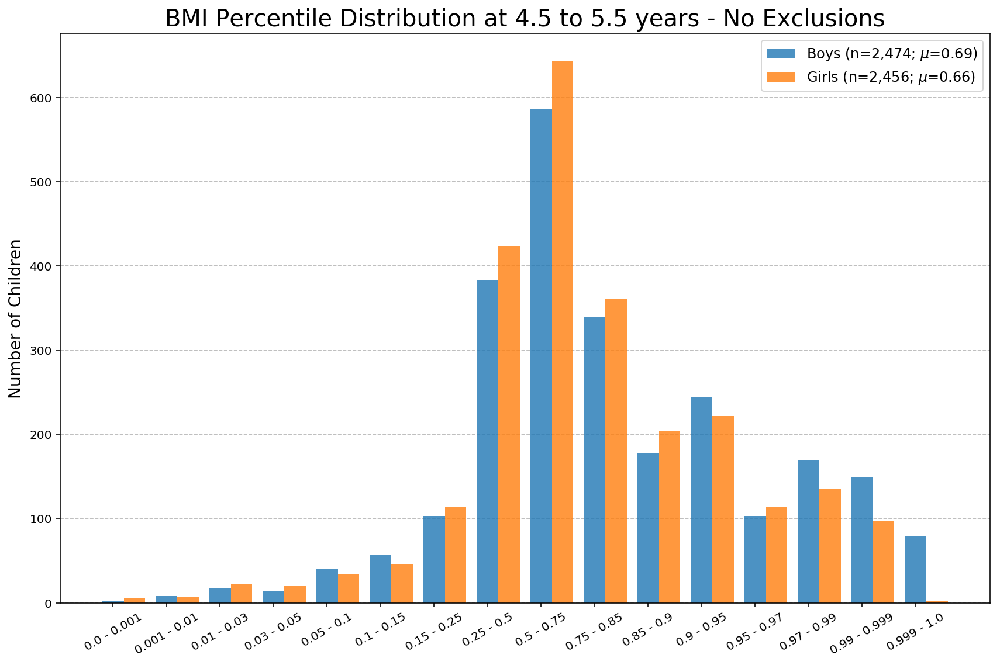

In [4]:
fig, ax = plt.subplots(figsize=(12,8))
index = np.arange(len(bins))
bar_width = 0.4
opacity = 0.8

bar1 = plt.bar(index, boys_bins, bar_width, alpha=opacity,
               label='Boys (n={0:,.0f}; $\mu$={1:,.2f})'.format(np.sum(boys_bins), np.mean(boys)))
 
bar2 = plt.bar(index + bar_width, girls_bins, bar_width, alpha=opacity,
               label='Girls (n={0:,.0f}; $\mu$={1:,.2f})'.format(np.sum(girls_bins), np.mean(girls)))

# plt.xlabel('Obesity Percentiles', fontsize=14)
plt.ylabel('Number of Children', fontsize=14)
plt.title('BMI Percentile Distribution at 4.5 to 5.5 years - No Exclusions', fontsize=20)
# plt.xticks(index + bar_width, ['{0:.1f}%'.format(b * 100) for b in bins])
plt.xticks(index, bin_names, rotation=30)
ax.yaxis.grid(linestyle='--')
ax.set_axisbelow(True)
plt.legend(fontsize=12)
 
plt.tight_layout()
# plt.savefig('../outputs_age_analyses20180221/no_exclusions_bmi_percentiles.png', dpi=96)
plt.show()

## Get the high risk kids for randomforests without exclusions

In [5]:
titles_total = pickle.load(open('../outputs_age_analyses20180221/titles_total.pkl', 'rb'))
model_list = pickle.load(open('../outputs_age_analyses20180221/model_list.pkl', 'rb'))

for k,ts in test_sets.items():
    xtest = ts[0]
    ytest = ts[1]
    ytestlabel = ts[2]
    mrnstest = ts[3]
    t = ts[5]
    title = ts[6]
 
    model = model_list[titles_total.index(title)]
    test_sets[k].append(model.predict(xtest))
    print((test_sets[k][7] > t).ravel().sum())
    
N = np.sum((test_sets[k][7] > test_sets[k][5]).ravel().sum() for k in test_sets.keys())
highrisk = np.zeros((N, x1.shape[1]+1))
highrisk_y = np.zeros((N, 2))
sums = 0
for k,ts in test_sets.items():
    xtest = ts[0]
    ytestlabel = ts[2]
    mrnstest = ts[3]
    x = ts[4]
    t = ts[5]
    ytestpred = ts[7]
    hr = (ytestpred > t)
    highrisk[sums:sums+hr.sum(),:] = np.hstack((mrnstest[hr].reshape(-1,1).astype(int), x[hr].astype(float)))
    highrisk_y[sums:sums+hr.sum(),:] = np.hstack((mrnstest[hr].reshape(-1,1).astype(int), ytestlabel[hr].reshape(-1,1).astype(int)))
    sums+=hr.sum()

df = pd.DataFrame(highrisk, columns=['mrns']+list(feature_headers))
df_y = pd.DataFrame(highrisk_y, columns=['mrns','obese'])
df = df.drop_duplicates(subset='mrns', keep='first')
df_y = df_y.drop_duplicates(subset='mrns', keep='first')
df.mrns = df.mrns.astype(int)
df_y.mrns = df_y.mrns.astype(int)

keys = []
for k in d1.keys():
    if d1[k]['mrn'] in df_y.mrns.values:
        keys.append(k)

# df_y

9
7


/Users/hammor01/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:41: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison


## Growth Curves for the 16 Highest Risk Kids in the Data Set

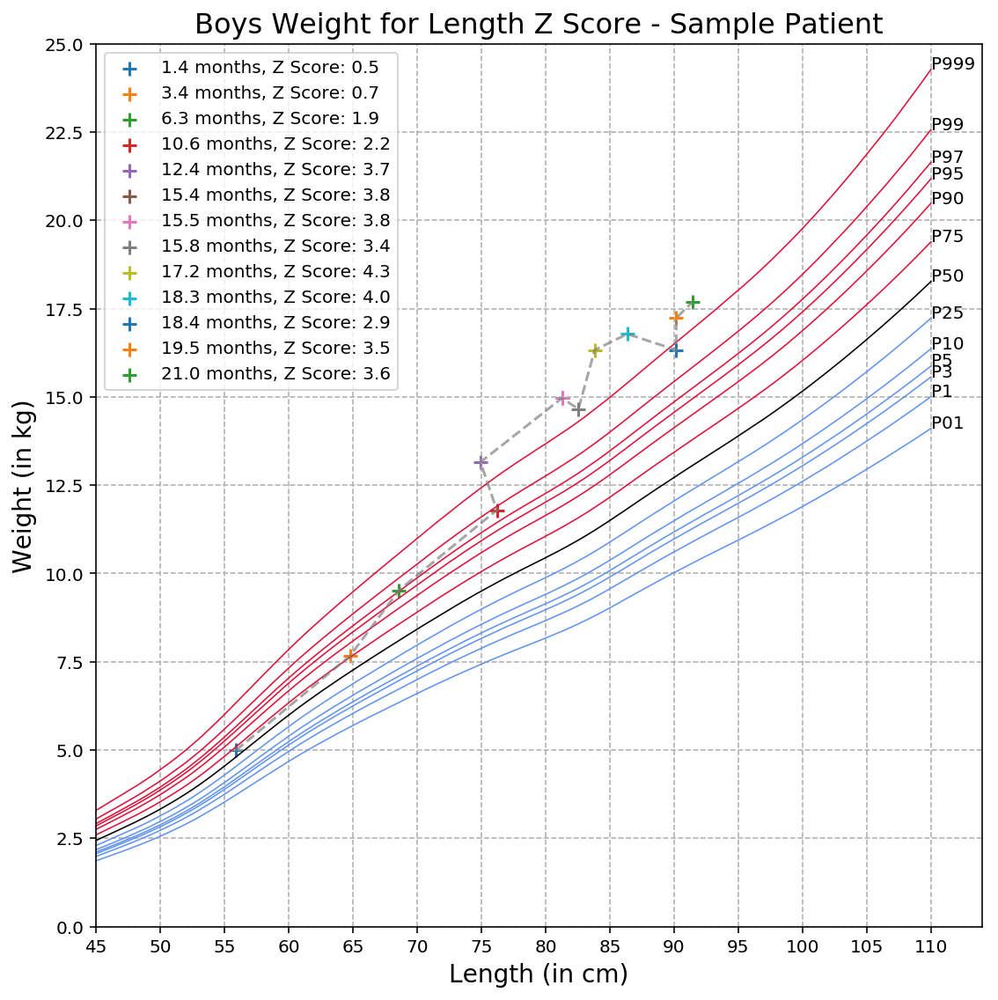

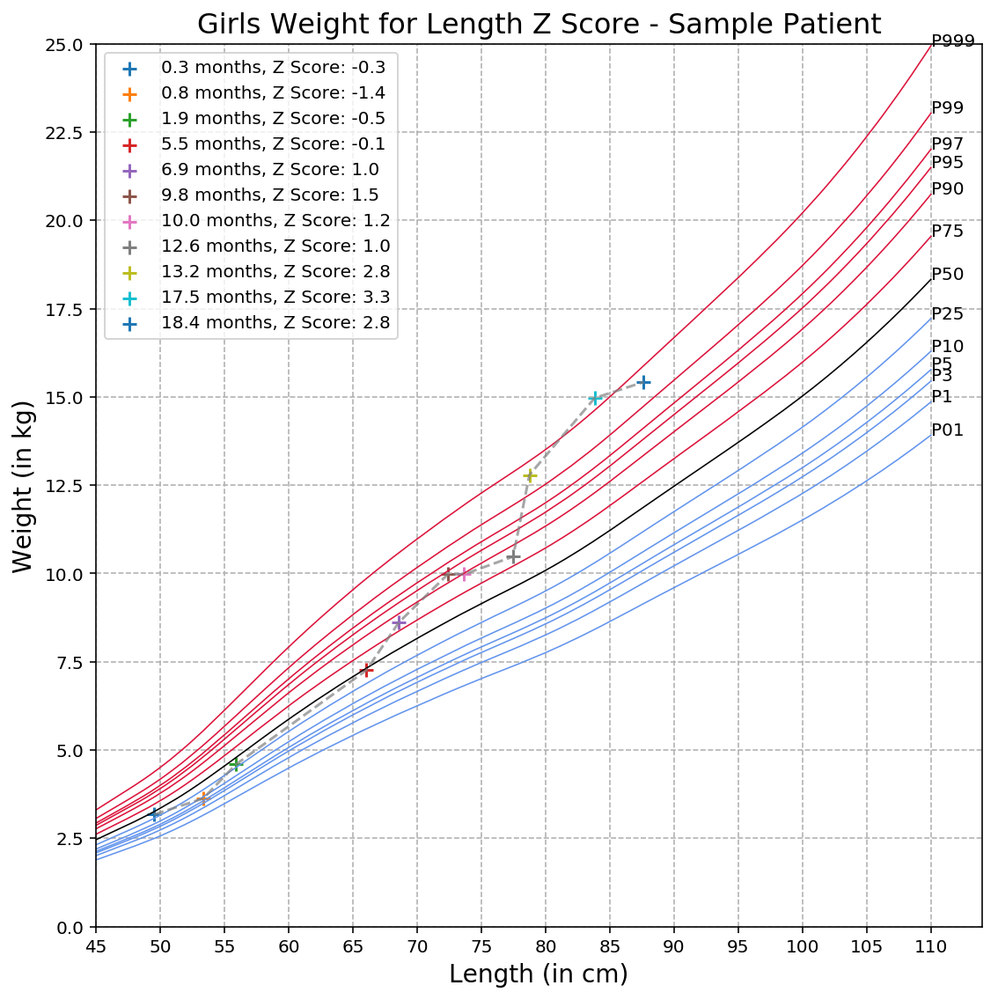

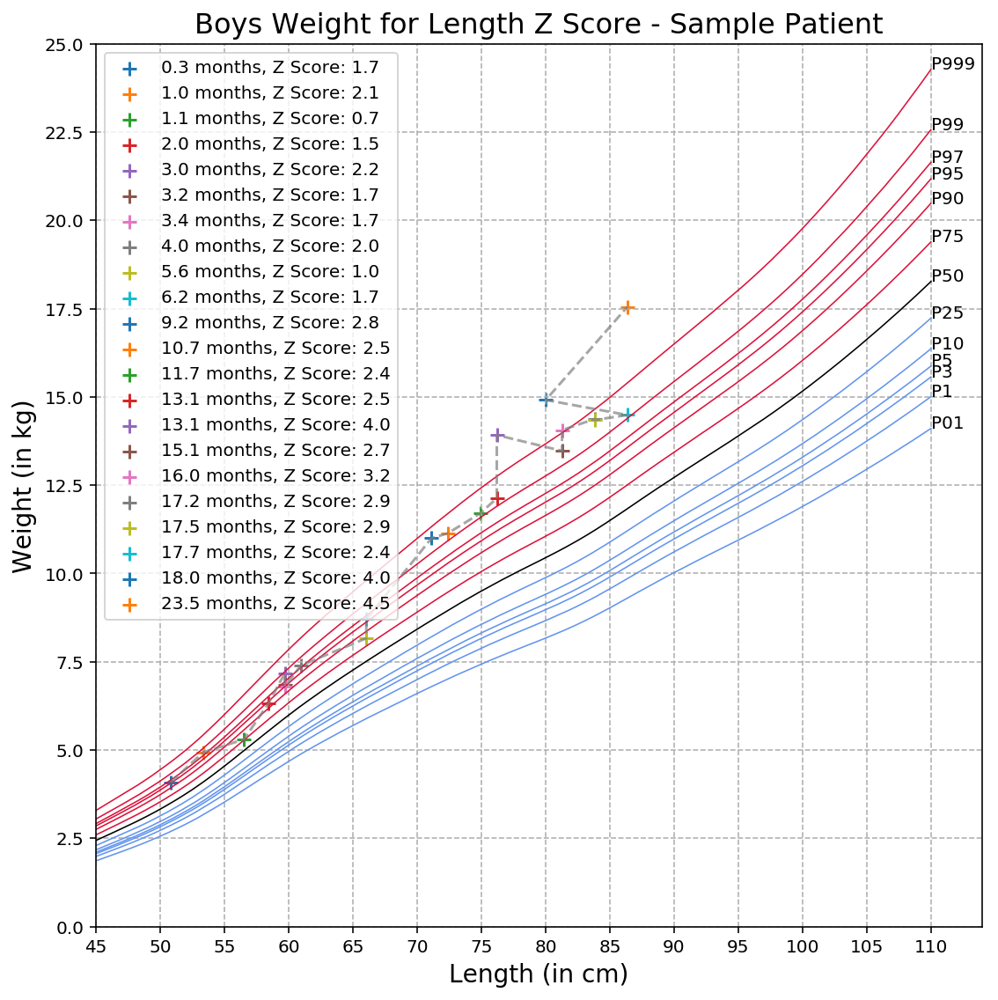

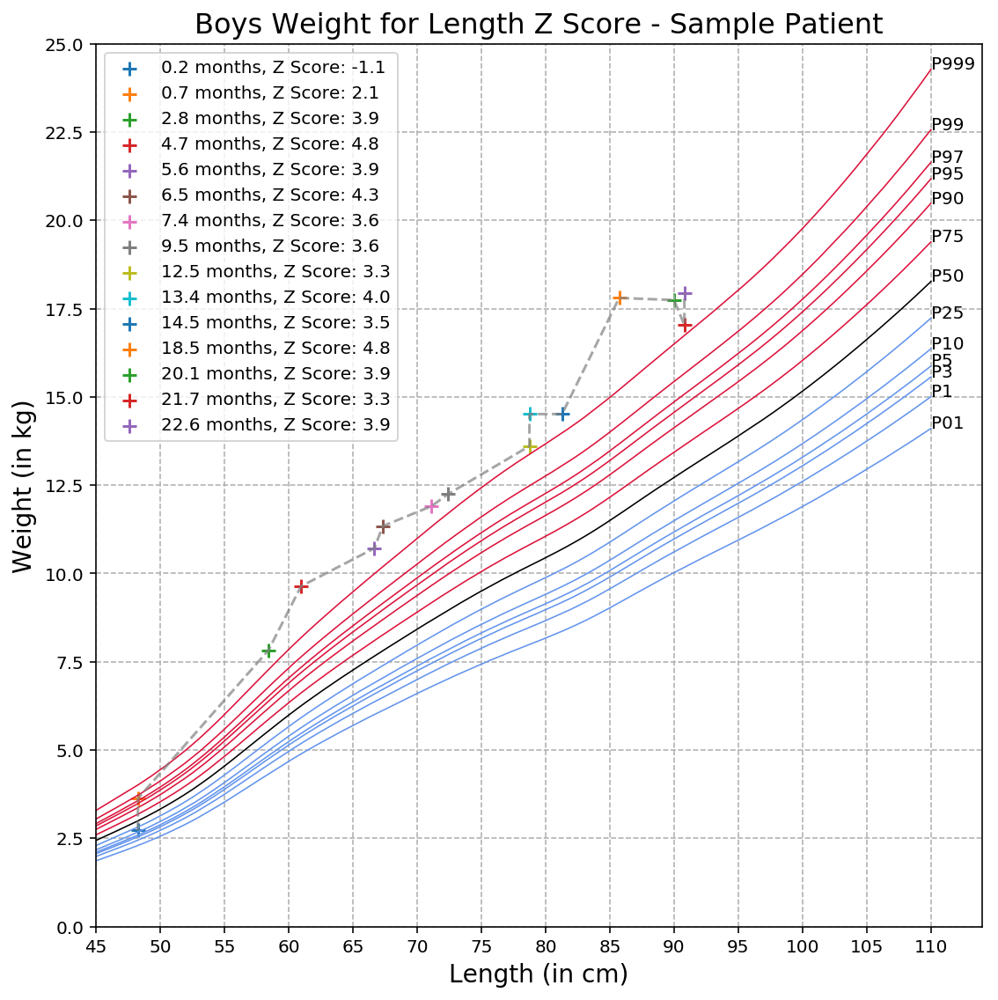

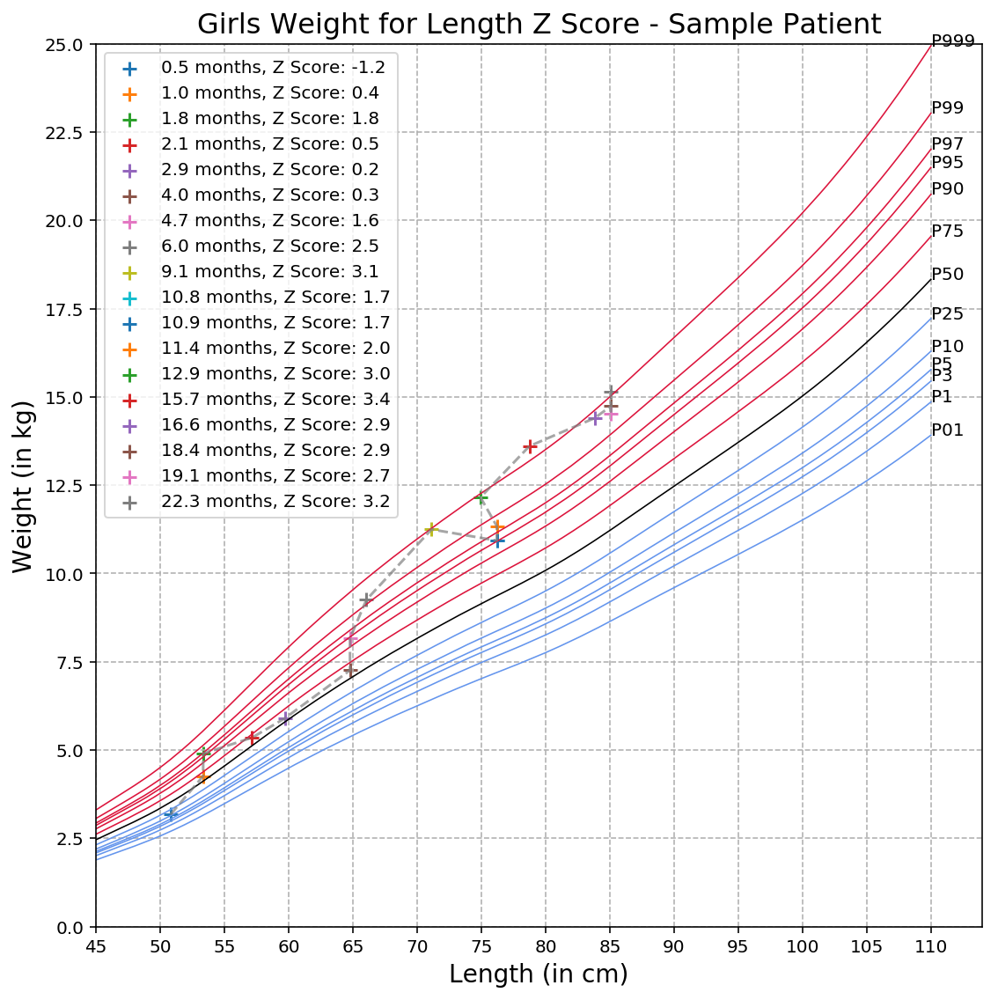

...

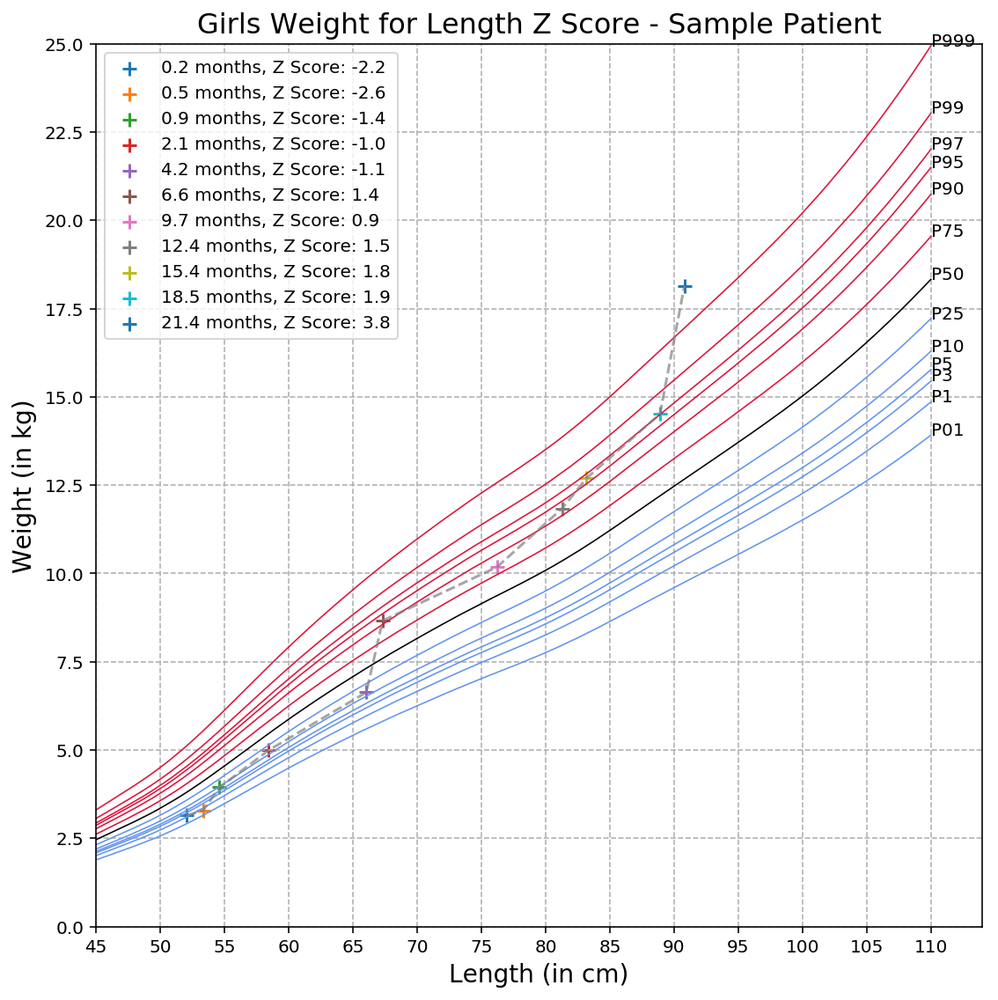

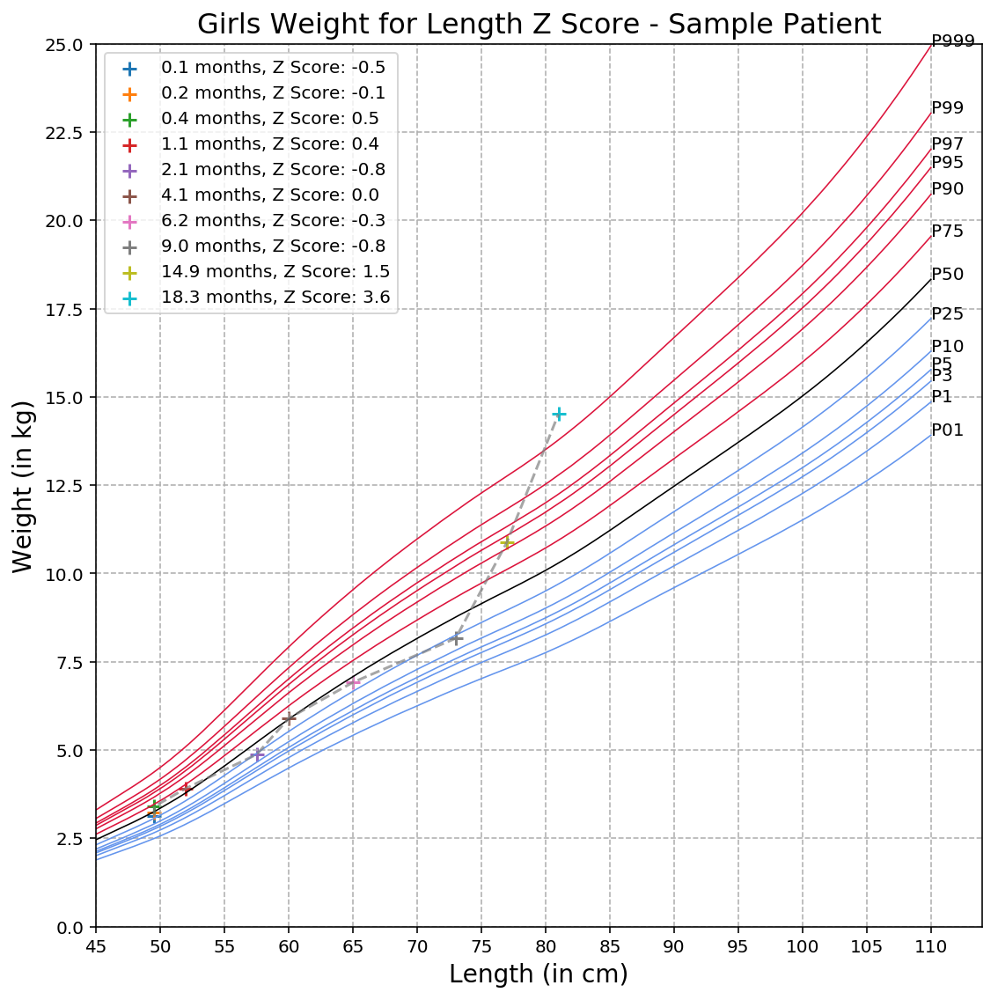

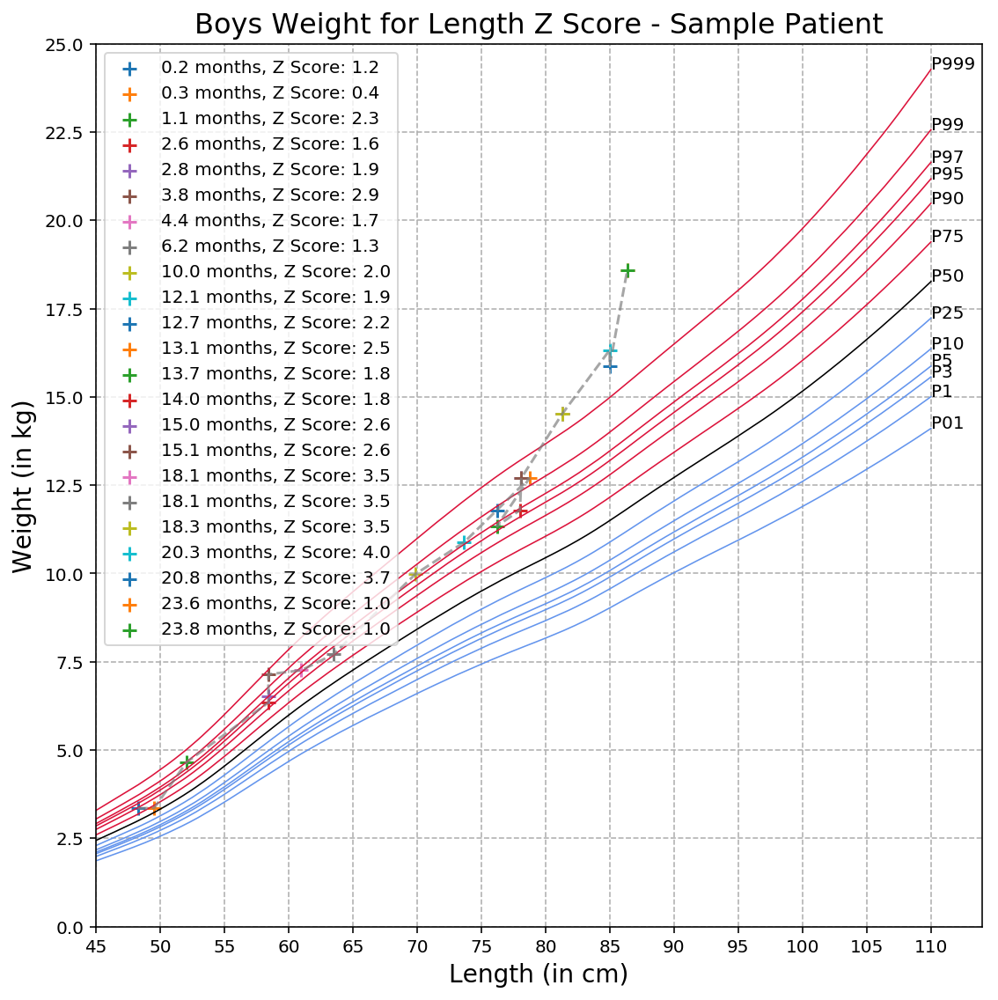

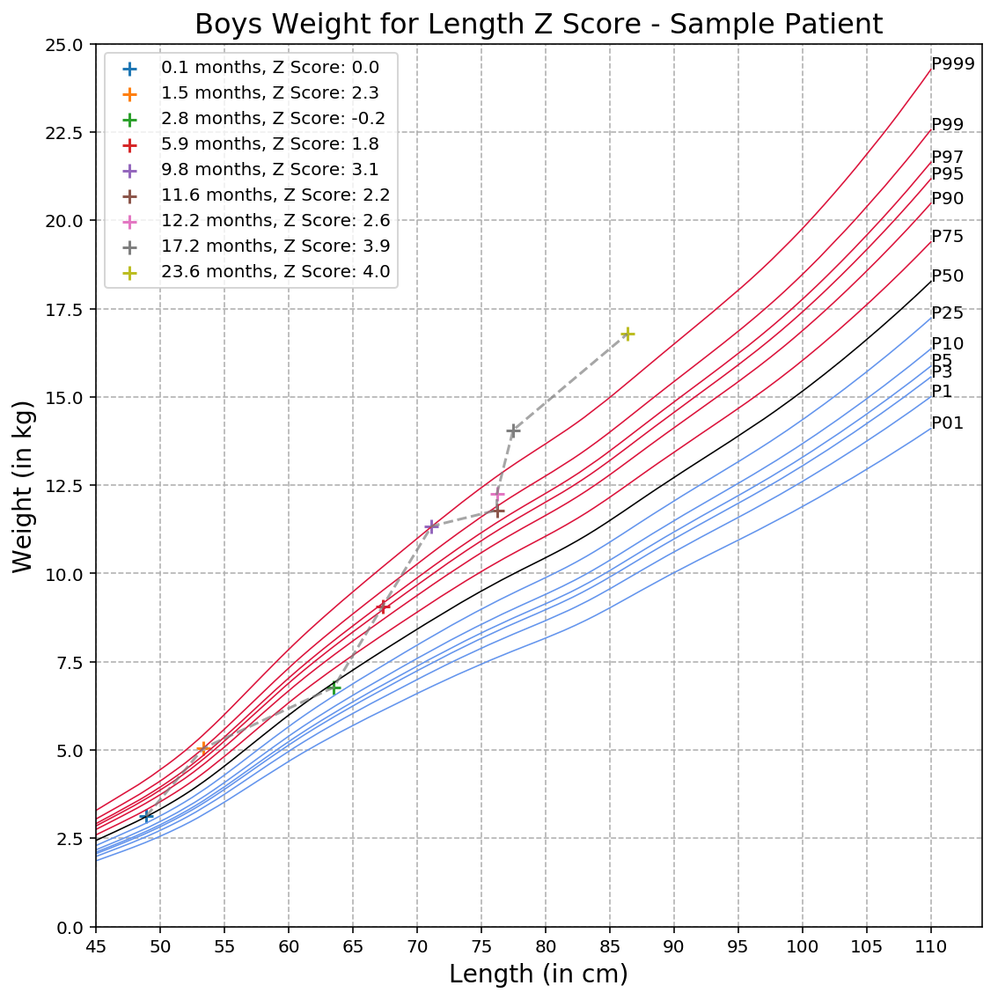

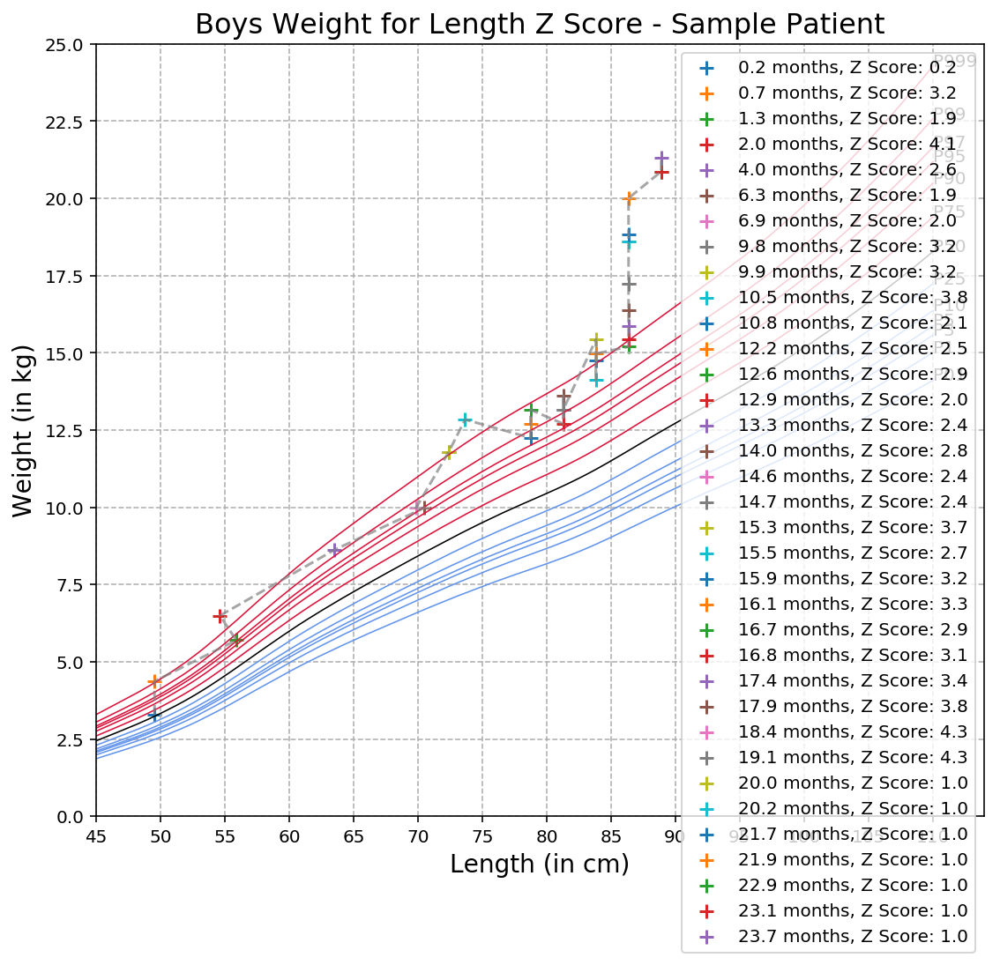

In [6]:
for k in keys:
    mrn = d1[k]['mrn']
#     fname = '../outputs_age_analyses20180221/growth_curve_'+str(mrn)+'.png'
    train.plot_growth_curve(d1,None,k, hide_mrn=True)

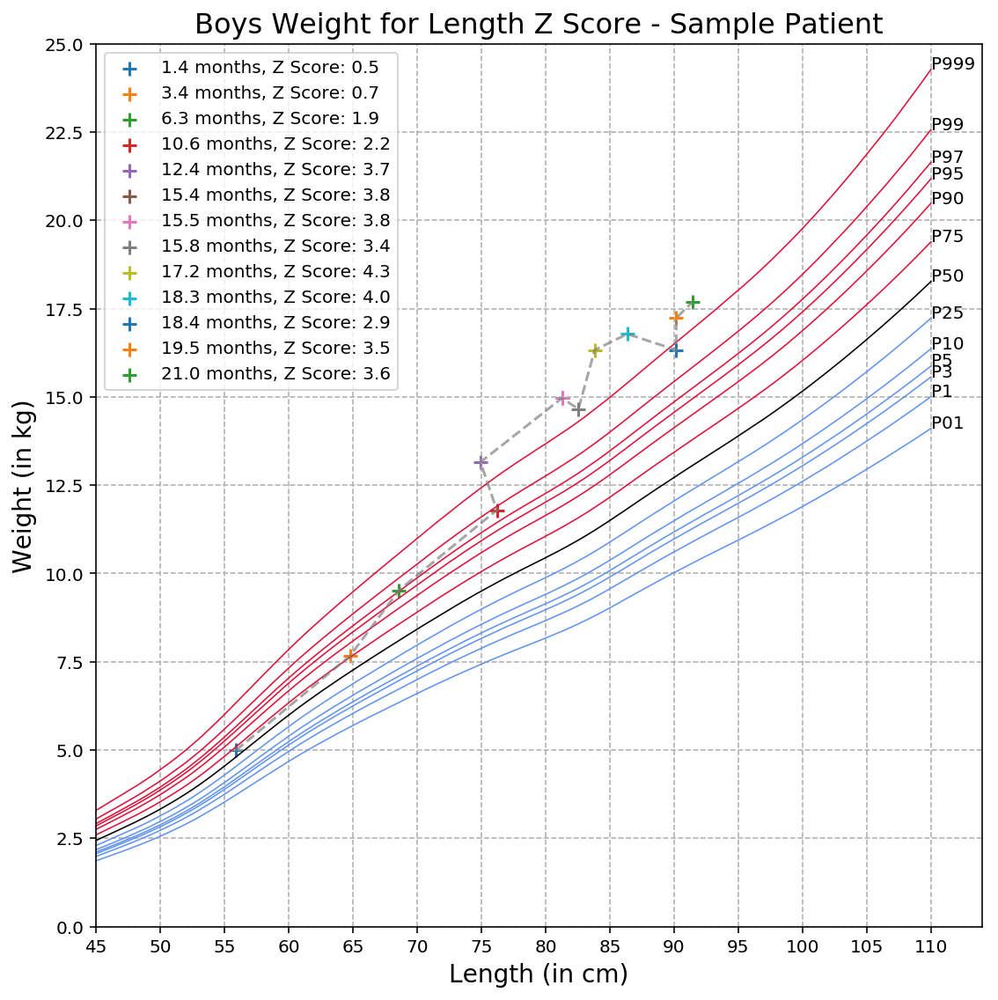

In [7]:
train.plot_growth_curve(d1,None,keys[0], hide_mrn=True)

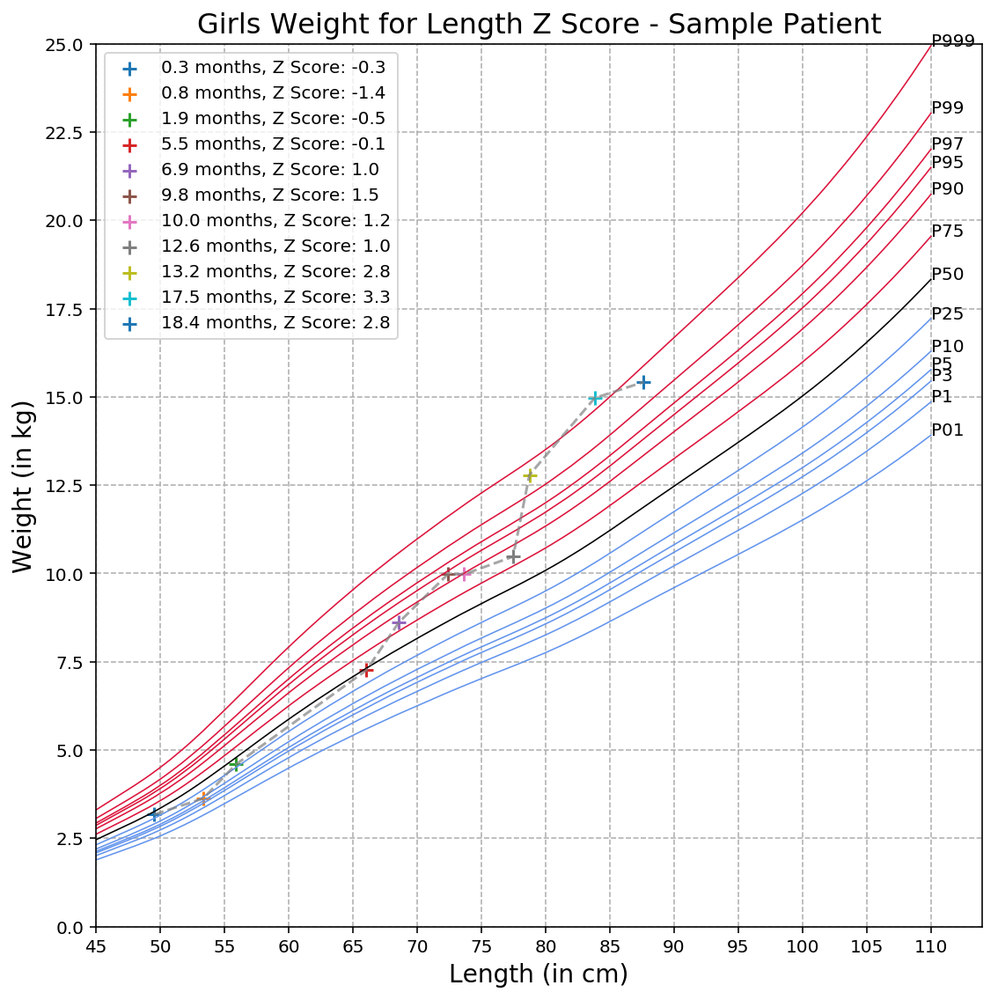

In [8]:
train.plot_growth_curve(d1,None,keys[1], hide_mrn=True)

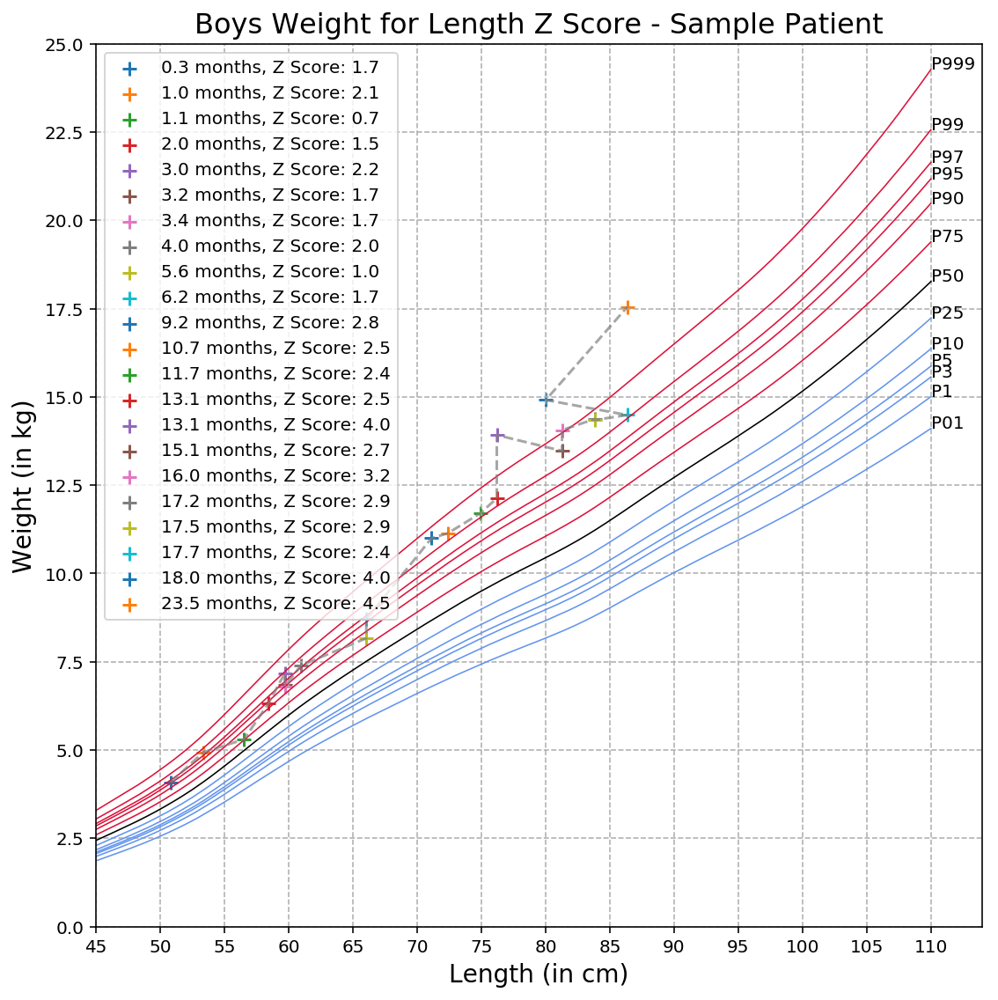

In [9]:
train.plot_growth_curve(d1,None,keys[2], hide_mrn=True)

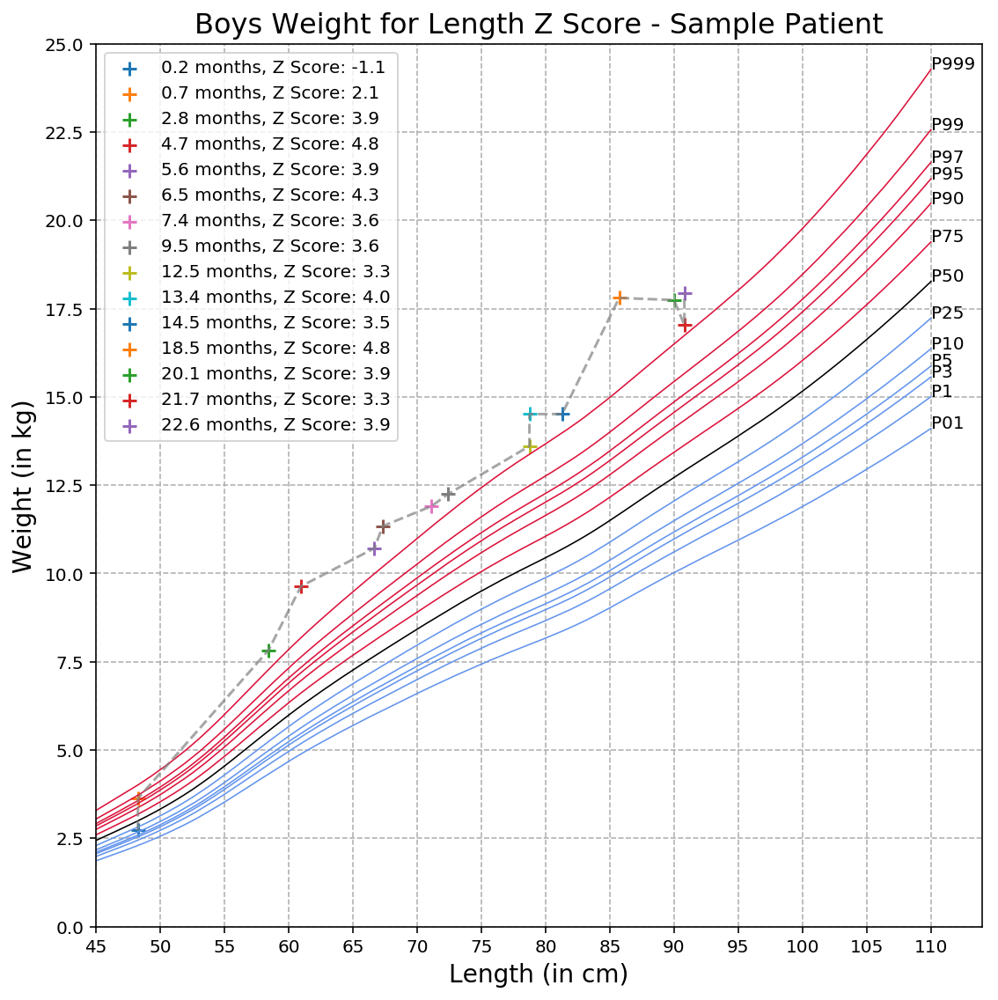

In [10]:
train.plot_growth_curve(d1,None,keys[3], hide_mrn=True)

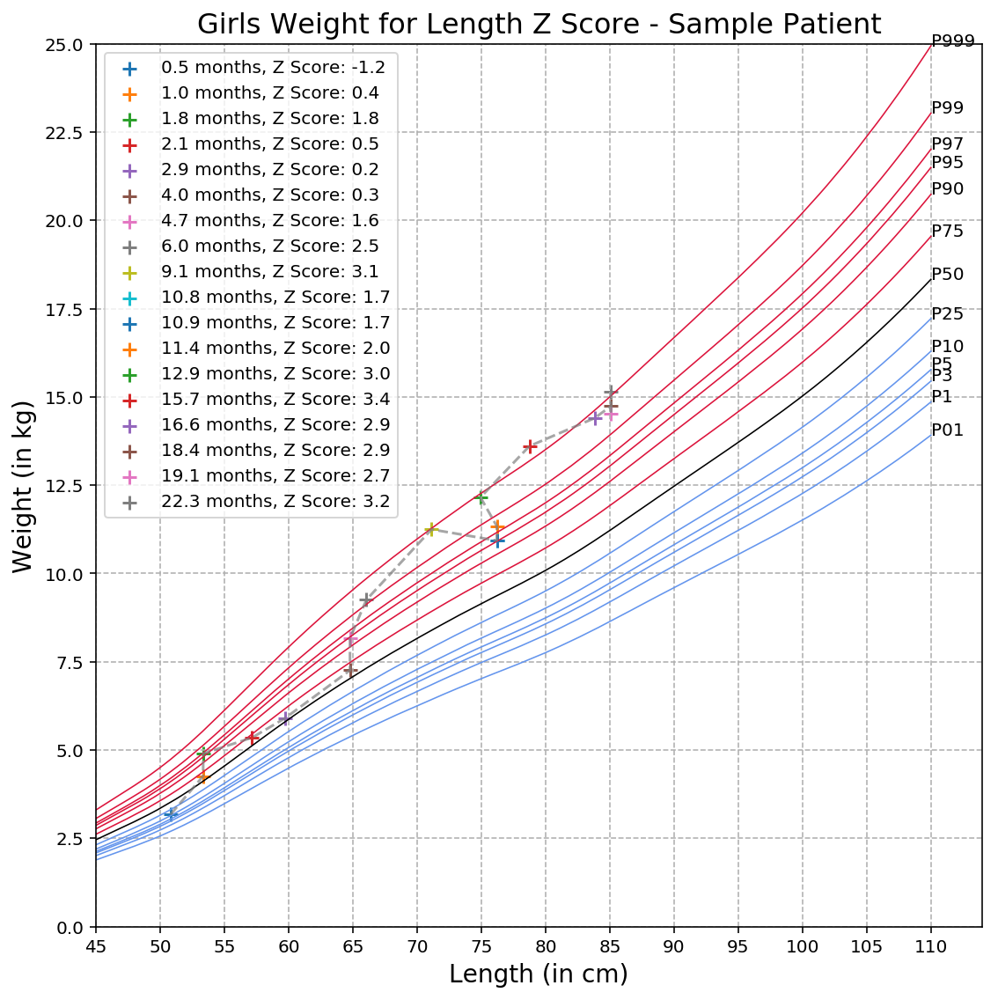

In [11]:
train.plot_growth_curve(d1,None,keys[4], hide_mrn=True)

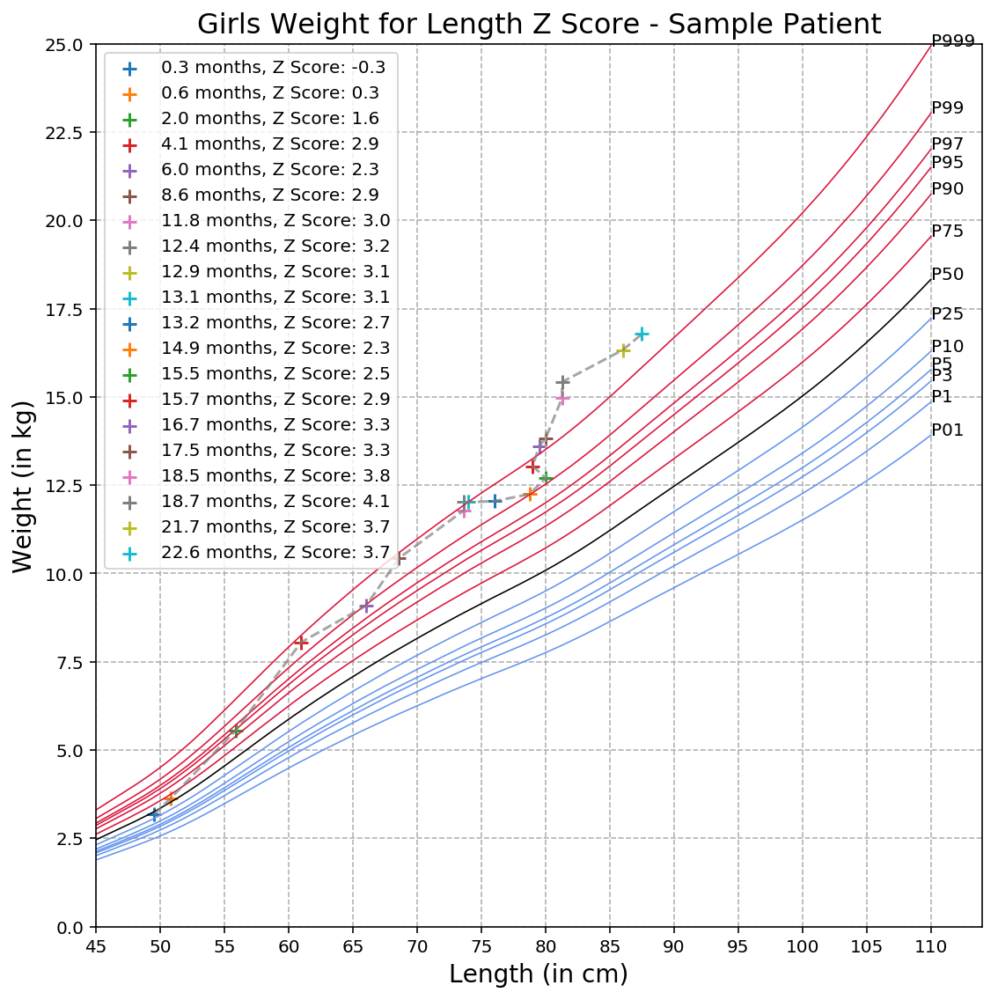

In [12]:
train.plot_growth_curve(d1,None,keys[5], hide_mrn=True)

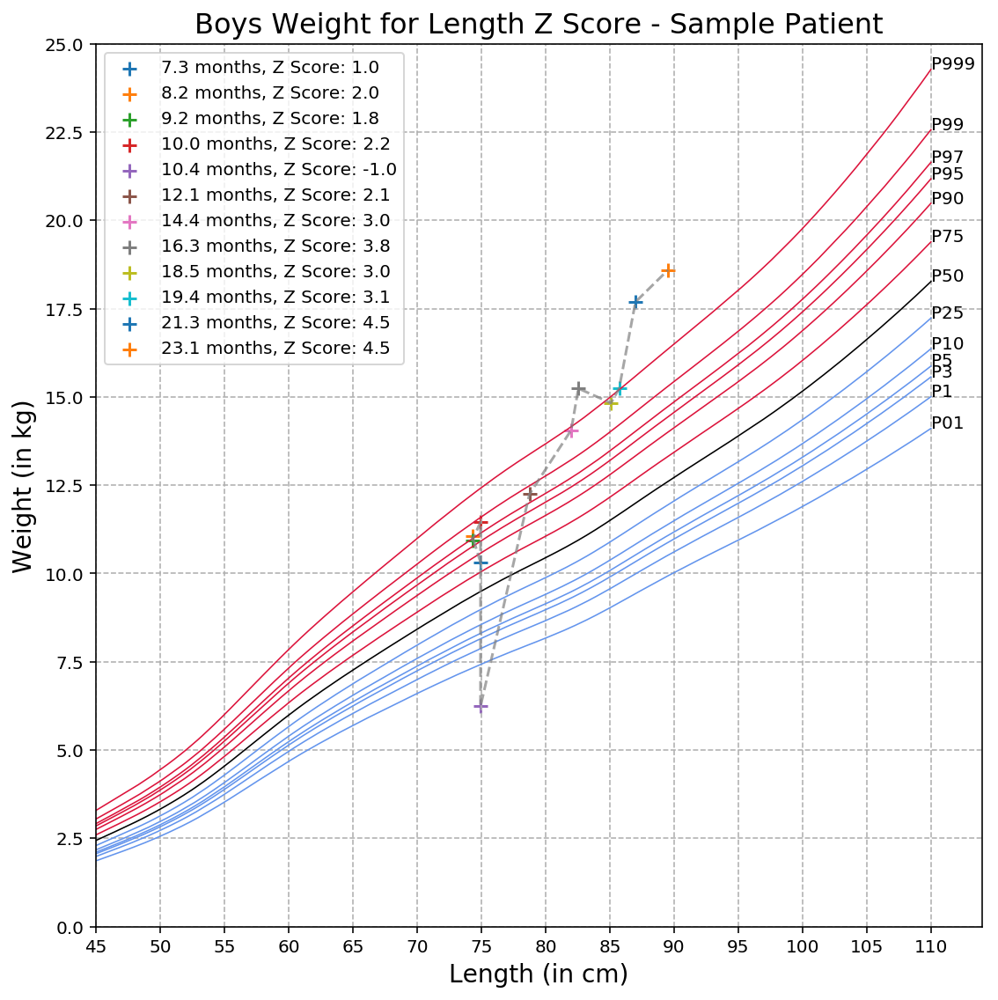

In [13]:
train.plot_growth_curve(d1,None,keys[6], hide_mrn=True)

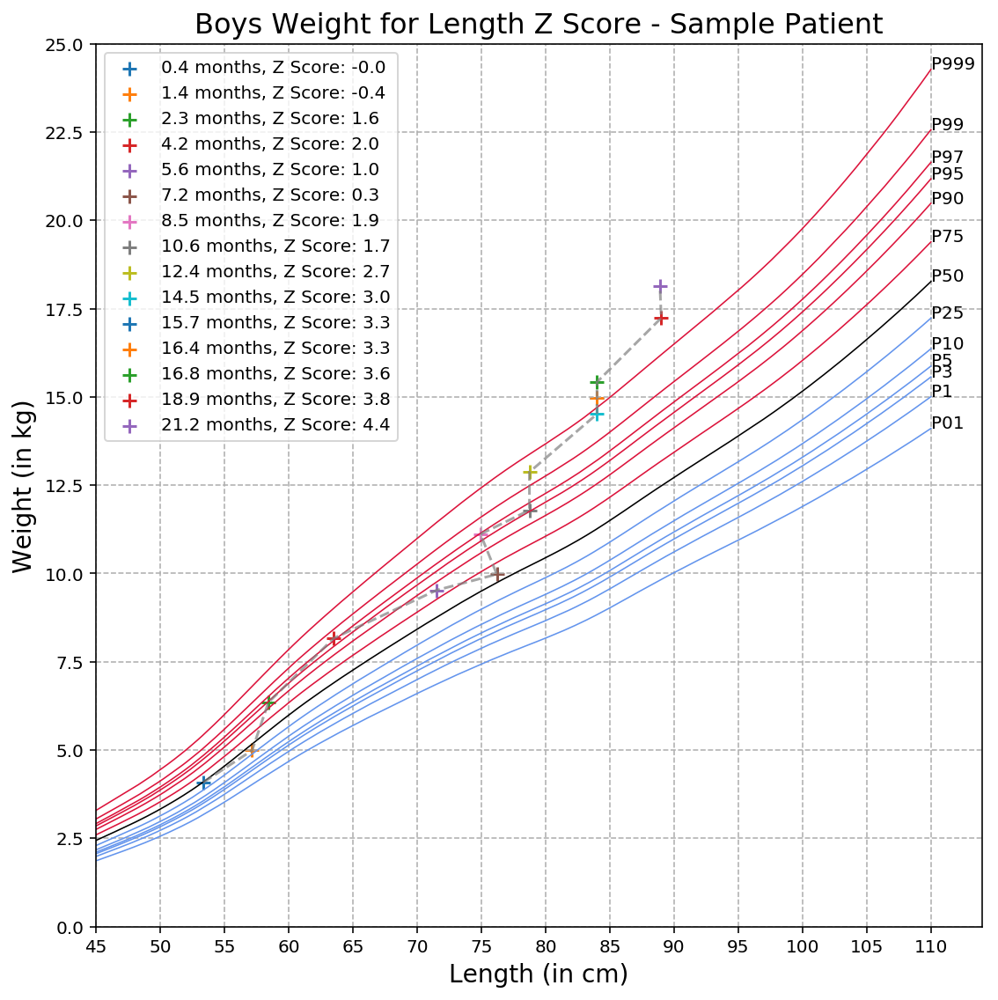

In [14]:
train.plot_growth_curve(d1,None,keys[7], hide_mrn=True)

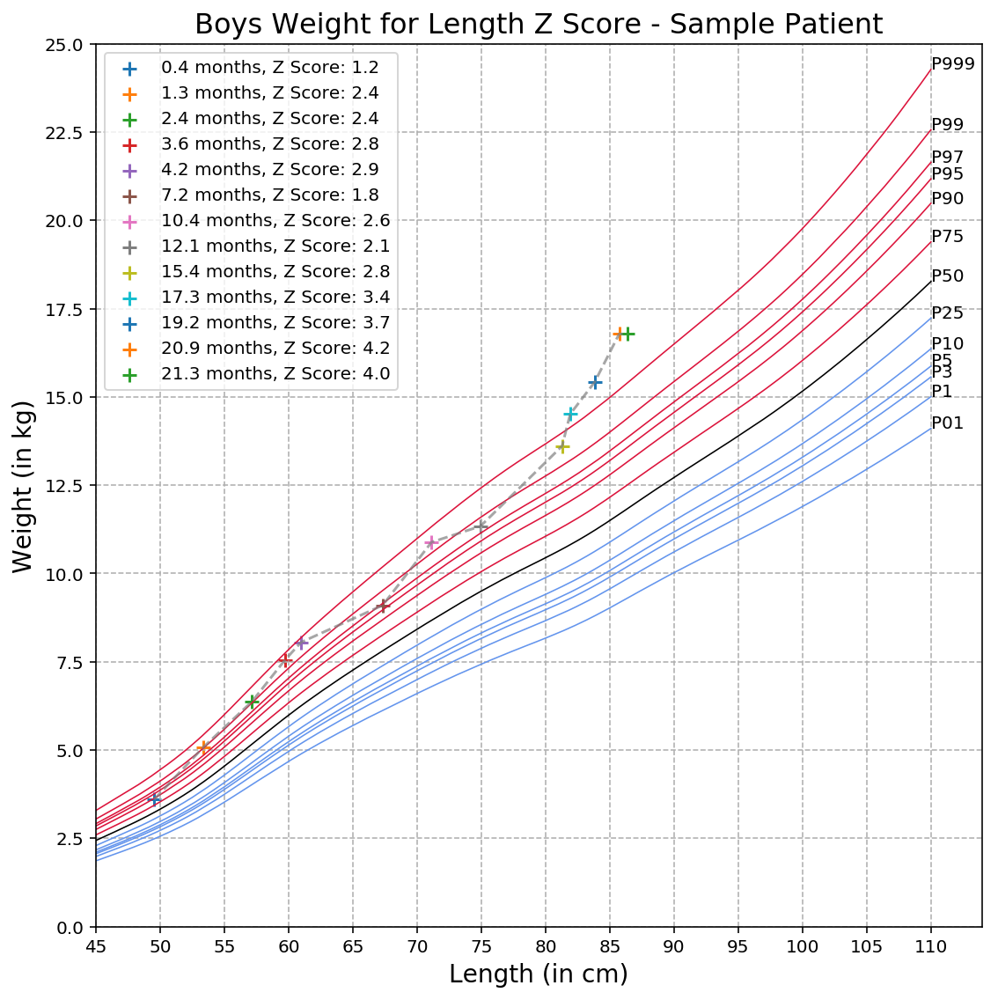

In [15]:
train.plot_growth_curve(d1,None,keys[8], hide_mrn=True)

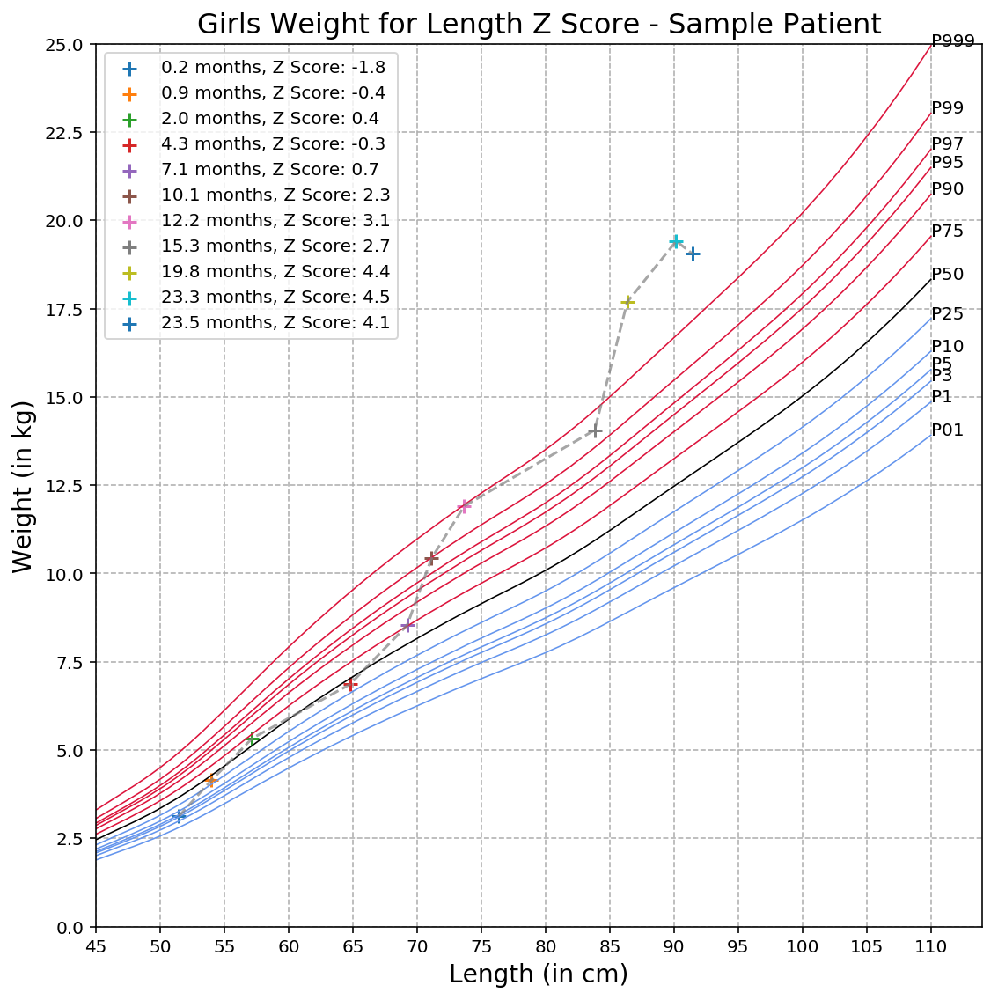

In [16]:
train.plot_growth_curve(d1,None,keys[9], hide_mrn=True)

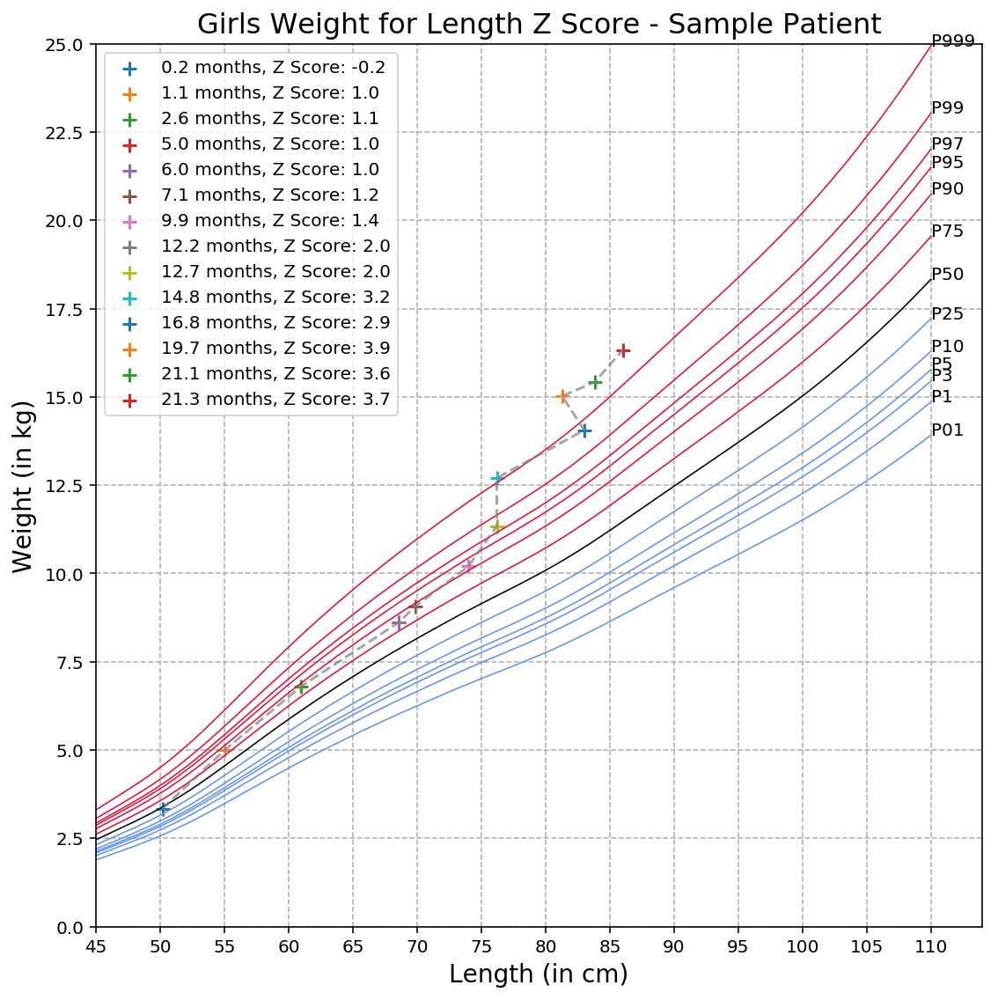

In [17]:
train.plot_growth_curve(d1,None,keys[10], hide_mrn=True)

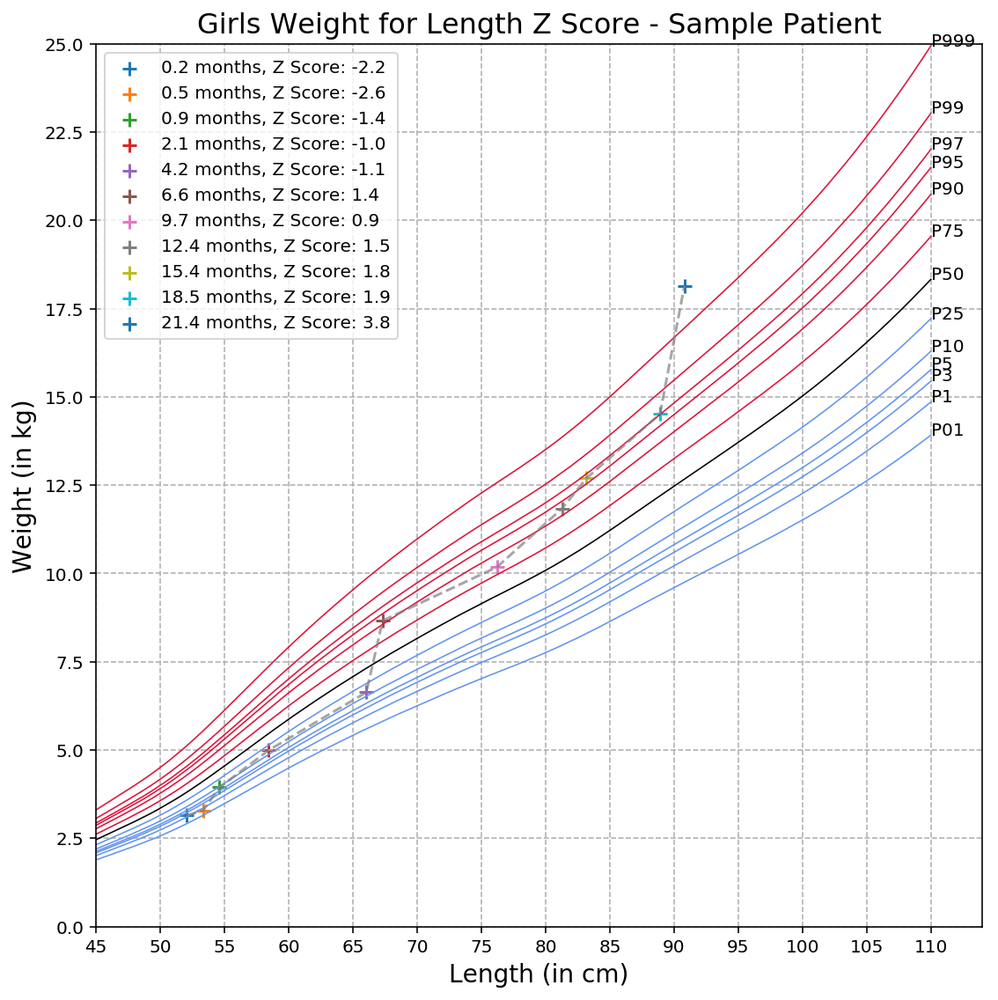

In [18]:
train.plot_growth_curve(d1,None,keys[11], hide_mrn=True)

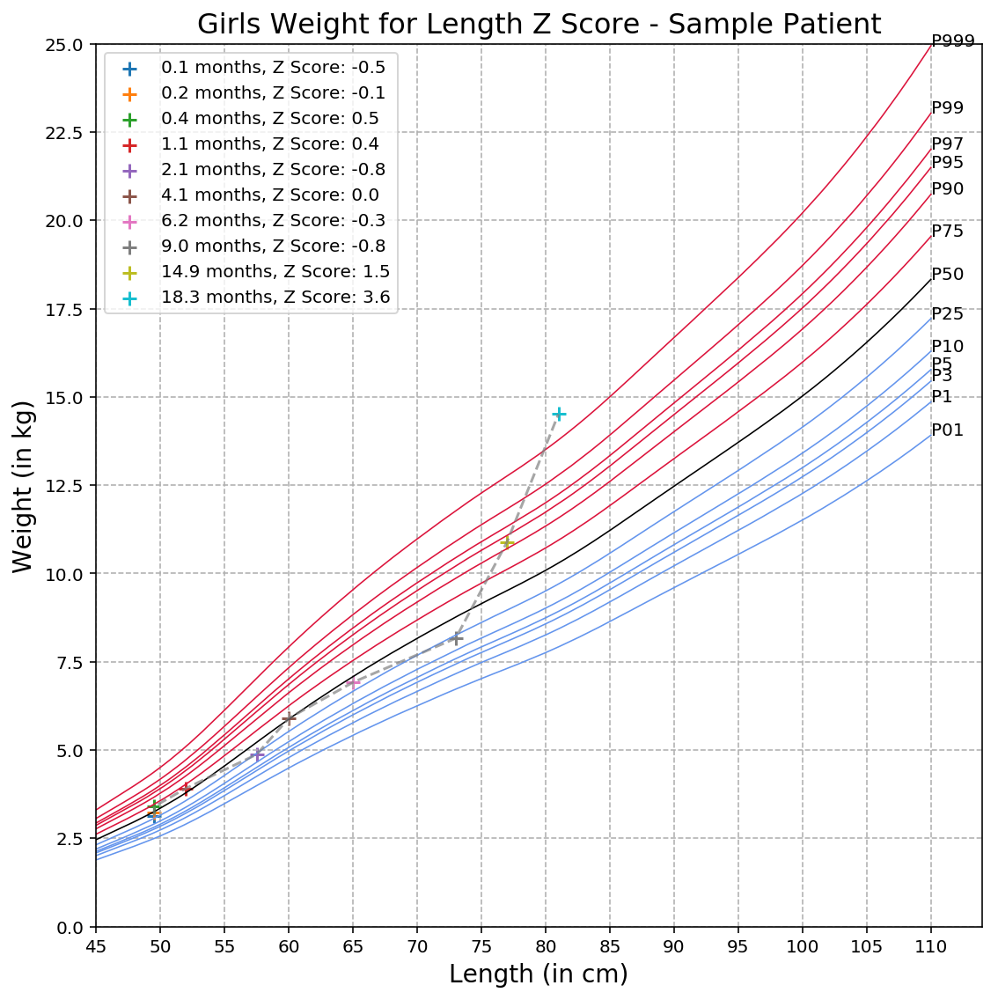

In [19]:
train.plot_growth_curve(d1,None,keys[12], hide_mrn=True)

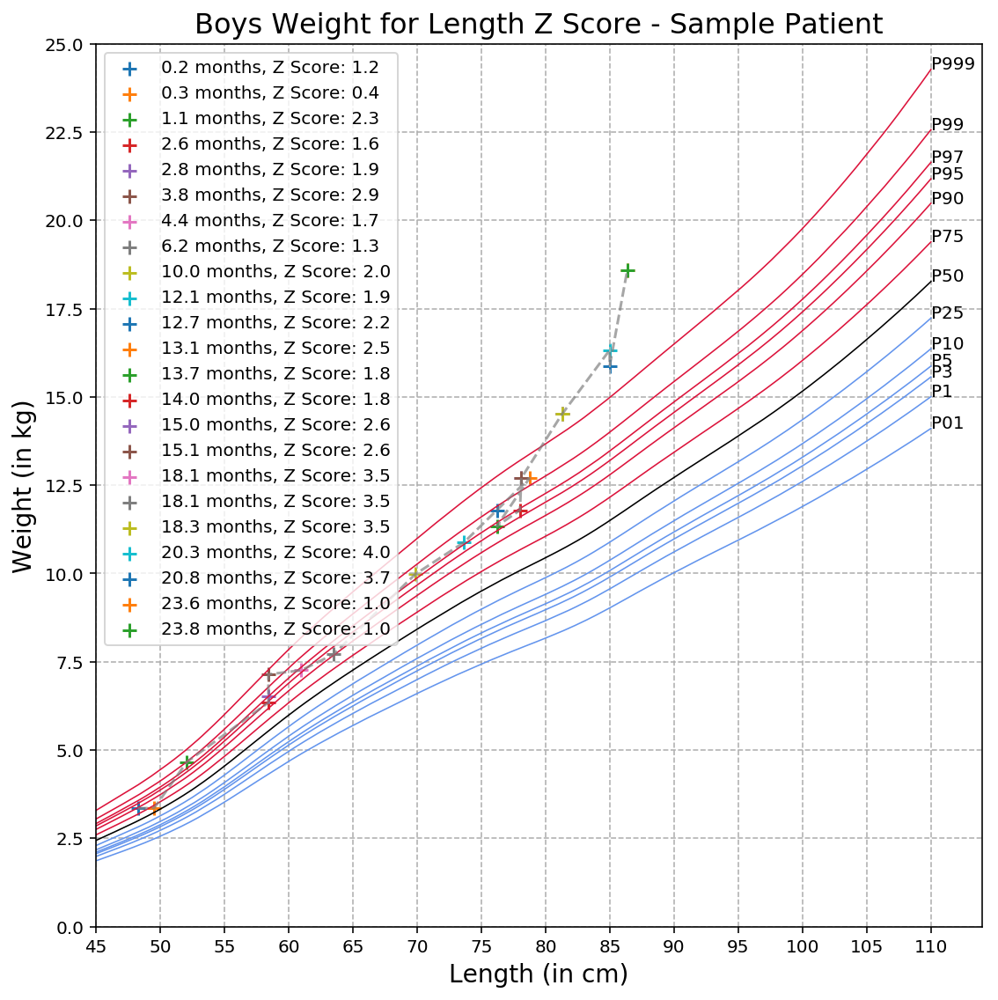

In [20]:
train.plot_growth_curve(d1,None,keys[13], hide_mrn=True)

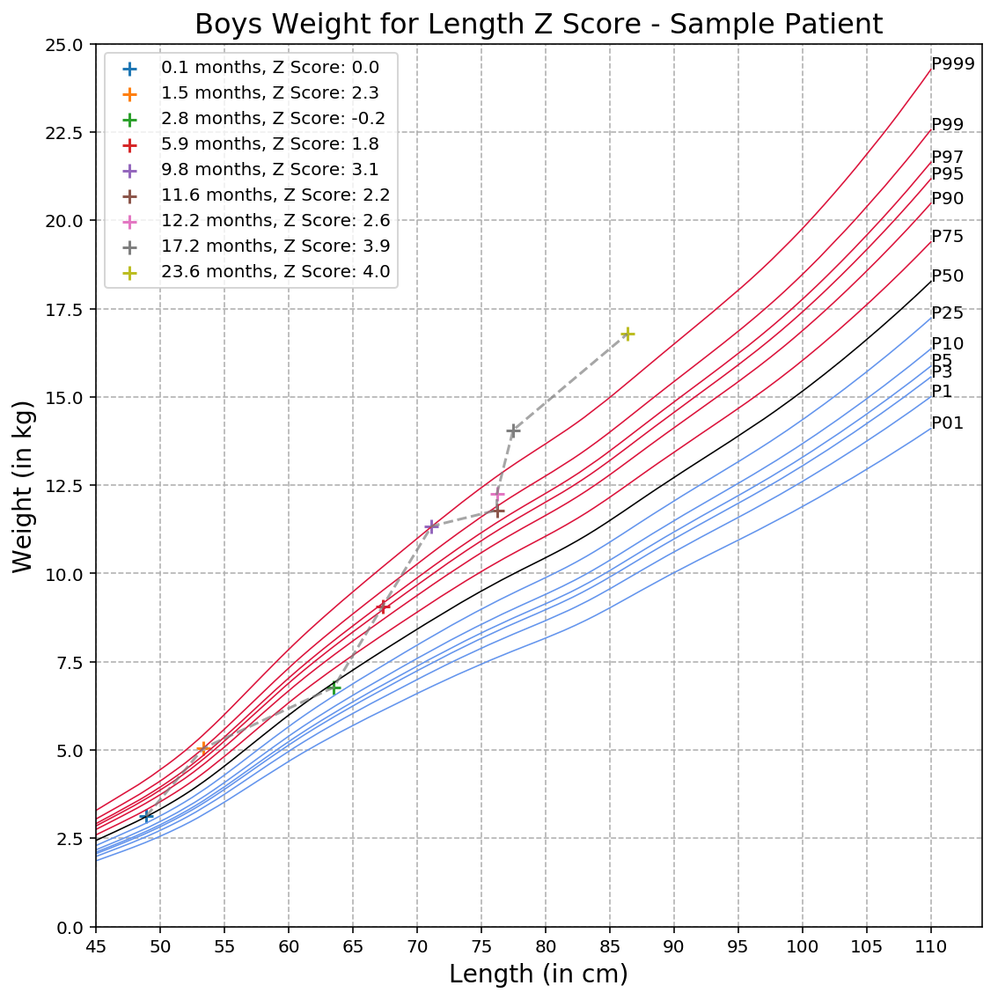

In [21]:
train.plot_growth_curve(d1,None,keys[14], hide_mrn=True)

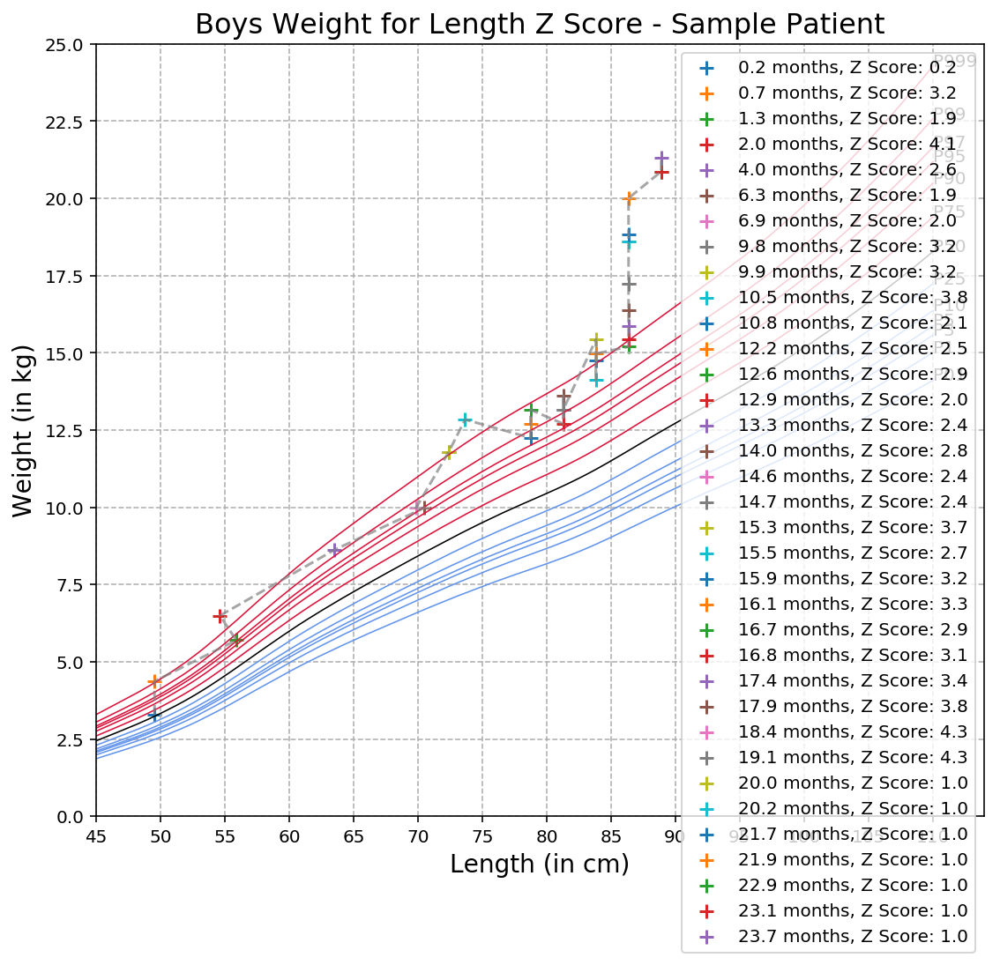

In [22]:
train.plot_growth_curve(d1,None,keys[15], hide_mrn=True)

# Load the results from the age varied predictions

In [23]:
auc_list_6 = pickle.load(open('../../out6/auc_list.pkl', 'rb'))
auc_list_12 = pickle.load(open('../../out12/auc_list.pkl', 'rb'))
auc_list_18 = pickle.load(open('../../out18/auc_list.pkl', 'rb'))
auc_list_24 = pickle.load(open('../../out24/auc_list.pkl', 'rb'))
auc_list_36 = pickle.load(open('../../out36/auc_list.pkl', 'rb'))
auc_list_48 = pickle.load(open('../../out48/auc_list.pkl', 'rb'))
auc_list = auc_list_6 + auc_list_12 + auc_list_18 + auc_list_24 + auc_list_36 + auc_list_48

titles_total_6 = pickle.load(open('../../out6/titles_total.pkl', 'rb'))
titles_total_12 = pickle.load(open('../../out12/titles_total.pkl', 'rb'),)
titles_total_18 = pickle.load(open('../../out18/titles_total.pkl', 'rb'))
titles_total_24 = pickle.load(open('../../out24/titles_total.pkl', 'rb'))
titles_total_36 = pickle.load(open('../../out36/titles_total.pkl', 'rb'))
titles_total_48 = pickle.load(open('../../out48/titles_total.pkl', 'rb'))
titles_total = titles_total_6 + titles_total_12 + titles_total_18 + titles_total_24 + titles_total_36 + titles_total_48

prec_total_6 = pickle.load(open('../../out6/prec_total.pkl', 'rb'))
prec_total_12 = pickle.load(open('../../out12/prec_total.pkl', 'rb'))
prec_total_18 = pickle.load(open('../../out18/prec_total.pkl', 'rb'))
prec_total_24 = pickle.load(open('../../out24/prec_total.pkl', 'rb'))
prec_total_36 = pickle.load(open('../../out36/prec_total.pkl', 'rb'),)
prec_total_48 = pickle.load(open('../../out48/prec_total.pkl', 'rb'))
prec_total = prec_total_6 + prec_total_12 + prec_total_18 + prec_total_24 + prec_total_36 + prec_total_48

recall_total_6 = pickle.load(open('../../out6/recall_total.pkl', 'rb'))
recall_total_18 = pickle.load(open('../../out18/recall_total.pkl', 'rb'))
recall_total_12 = pickle.load(open('../../out12/recall_total.pkl', 'rb'))
recall_total_24 = pickle.load(open('../../out24/recall_total.pkl', 'rb'))
recall_total_36 = pickle.load(open('../../out36/recall_total.pkl', 'rb'))
recall_total_48 = pickle.load(open('../../out48/recall_total.pkl', 'rb'))
recall_total = recall_total_6 + recall_total_12 + recall_total_18 + recall_total_24 + recall_total_36 + recall_total_48

spec_total_6 = pickle.load(open('../../out6/spec_total.pkl', 'rb'))
spec_total_18 = pickle.load(open('../../out18/spec_total.pkl', 'rb'))
spec_total_12 = pickle.load(open('../../out12/spec_total.pkl', 'rb'))
spec_total_24 = pickle.load(open('../../out24/spec_total.pkl', 'rb'))
spec_total_36 = pickle.load(open('../../out36/spec_total.pkl', 'rb'))
spec_total_48 = pickle.load(open('../../out48/spec_total.pkl', 'rb'))
spec_total = spec_total_6 + spec_total_12 + spec_total_18 + spec_total_24 + spec_total_36 + spec_total_48

# Results for the most predictive feature: 'Vital: BMI-latest'

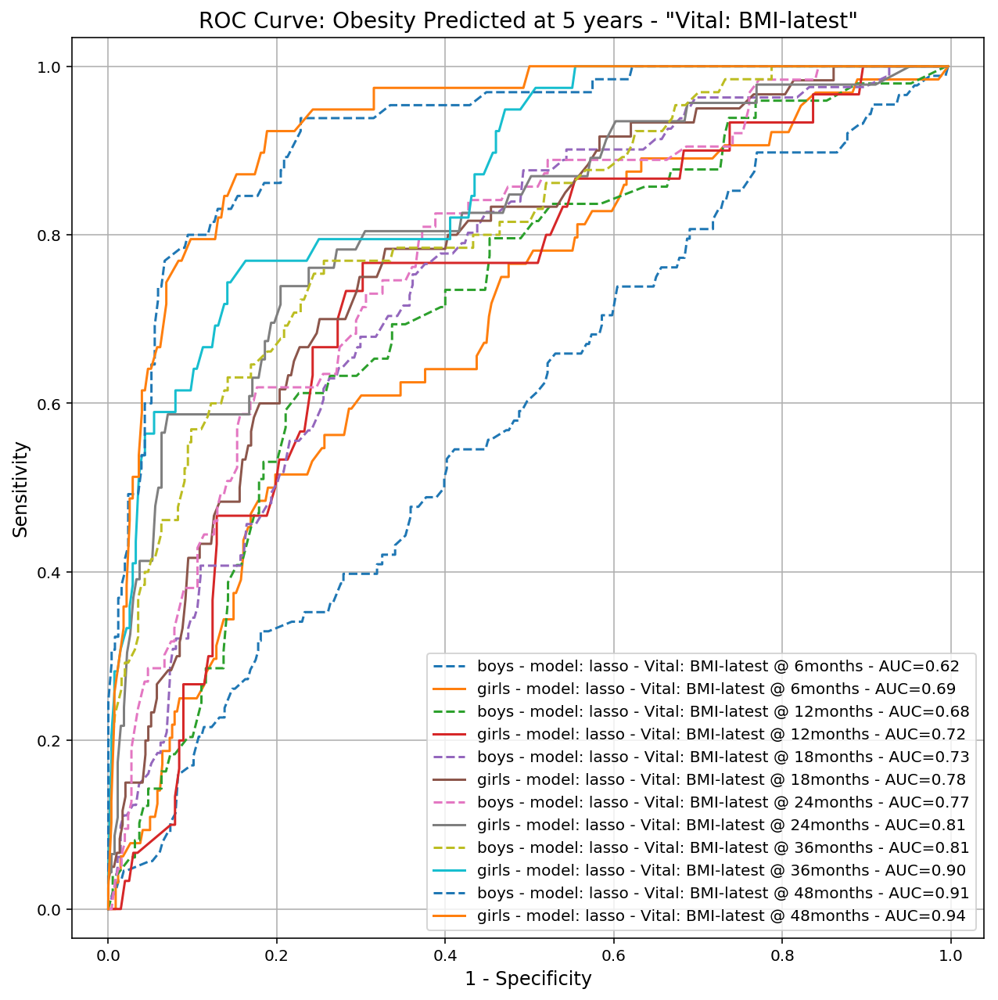

In [24]:
modelix = 'BMI'
plt.figure(figsize=(9,9))
for ix in range(len(prec_total)):
    if modelix not in titles_total[ix] or 'randomforest' in titles_total[ix] or 'gradientboost' in titles_total[ix]:
        continue
    if 'girls' in titles_total[ix]:
        plt.plot(1- np.array(spec_total[ix]), np.array(recall_total[ix]), linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        plt.plot(1- np.array(spec_total[ix]), np.array(recall_total[ix]), linestyle='--', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))

plt.legend(fontsize = 10)
plt.xlabel('1 - Specificity', fontsize=12)
plt.ylabel('Sensitivity', fontsize=12)
plt.axis('equal')
plt.title('ROC Curve: Obesity Predicted at 5 years - "Vital: BMI-latest"', fontsize=14)
plt.grid(True)
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_ROC.png', dpi=300)
plt.show()

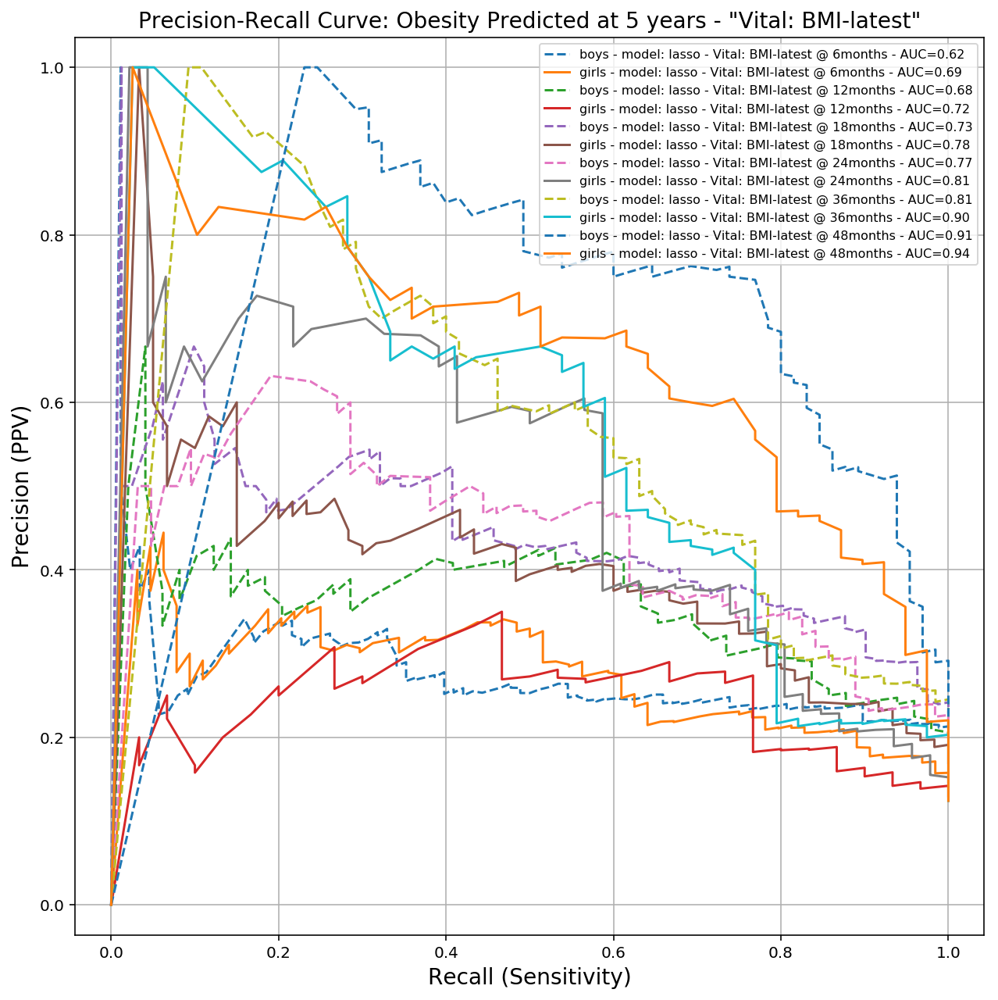

In [25]:
plt.figure(figsize=(9,9))
for ix in range(len(prec_total)):
    if modelix not in titles_total[ix] or 'randomforest' in titles_total[ix] or 'gradientboost' in titles_total[ix]:
        continue
    if 'girls' in titles_total[ix]:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='--', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
plt.xlabel('Recall (Sensitivity)', fontsize=14)
plt.ylabel('Precision (PPV)', fontsize=14)
plt.legend(fontsize = 8)
plt.axis('equal')
plt.title('Precision-Recall Curve: Obesity Predicted at 5 years - "Vital: BMI-latest"', fontsize=14)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

# LASSO and Random Forest Comparison for Boys and Girls

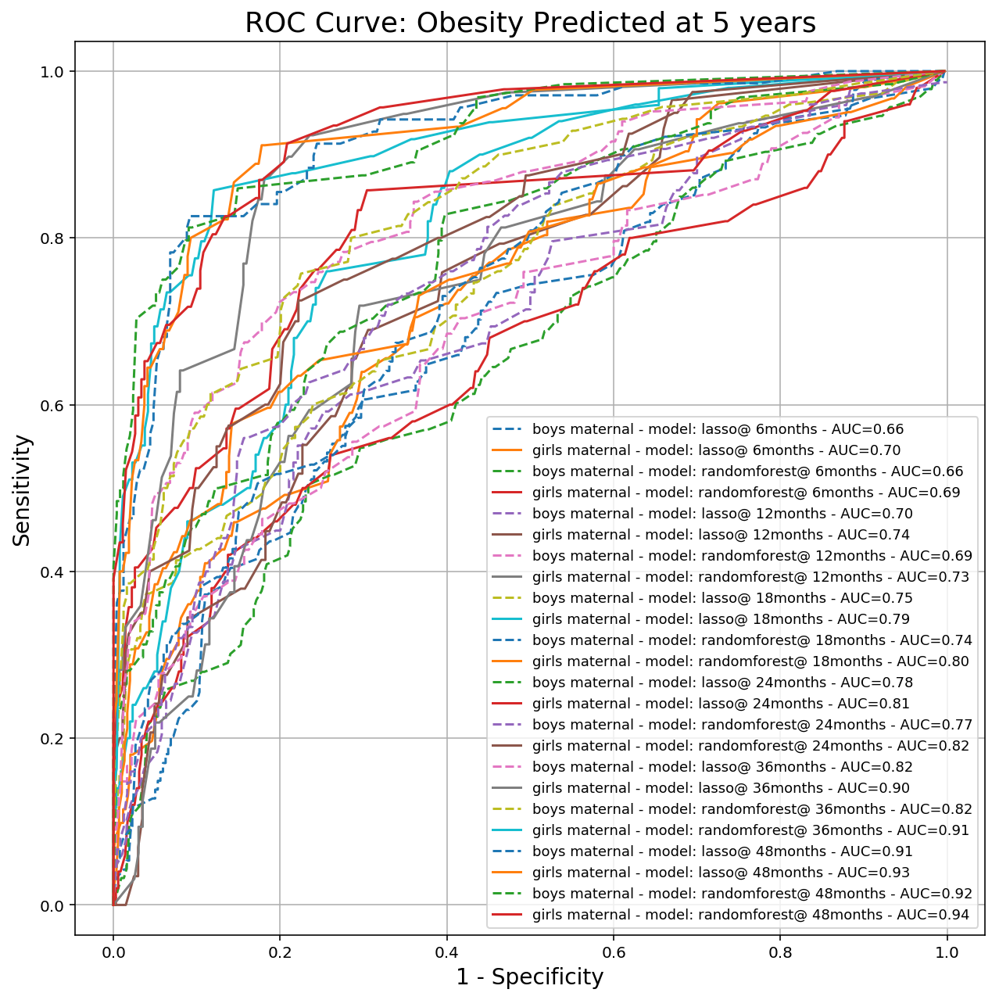

In [26]:
plt.figure(figsize=(9,9))
for ix in range(len(prec_total)):
    if any(x in titles_total[ix] for x in ('w/o vitals','Wt','no_maternal','w/o exclusions', 'BMI','gradientboost')):
        continue
    if 'girls' in titles_total[ix]:
        plt.plot(1- np.array(spec_total[ix]), np.array(recall_total[ix]), linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        plt.plot(1- np.array(spec_total[ix]), np.array(recall_total[ix]), linestyle='--', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))

plt.legend(fontsize = 9)
plt.xlabel('1 - Specificity', fontsize = 14)
plt.ylabel('Sensitivity', fontsize = 14)
plt.axis('equal')
plt.title('ROC Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid(True)
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_ROC.png', dpi=300)
plt.show()

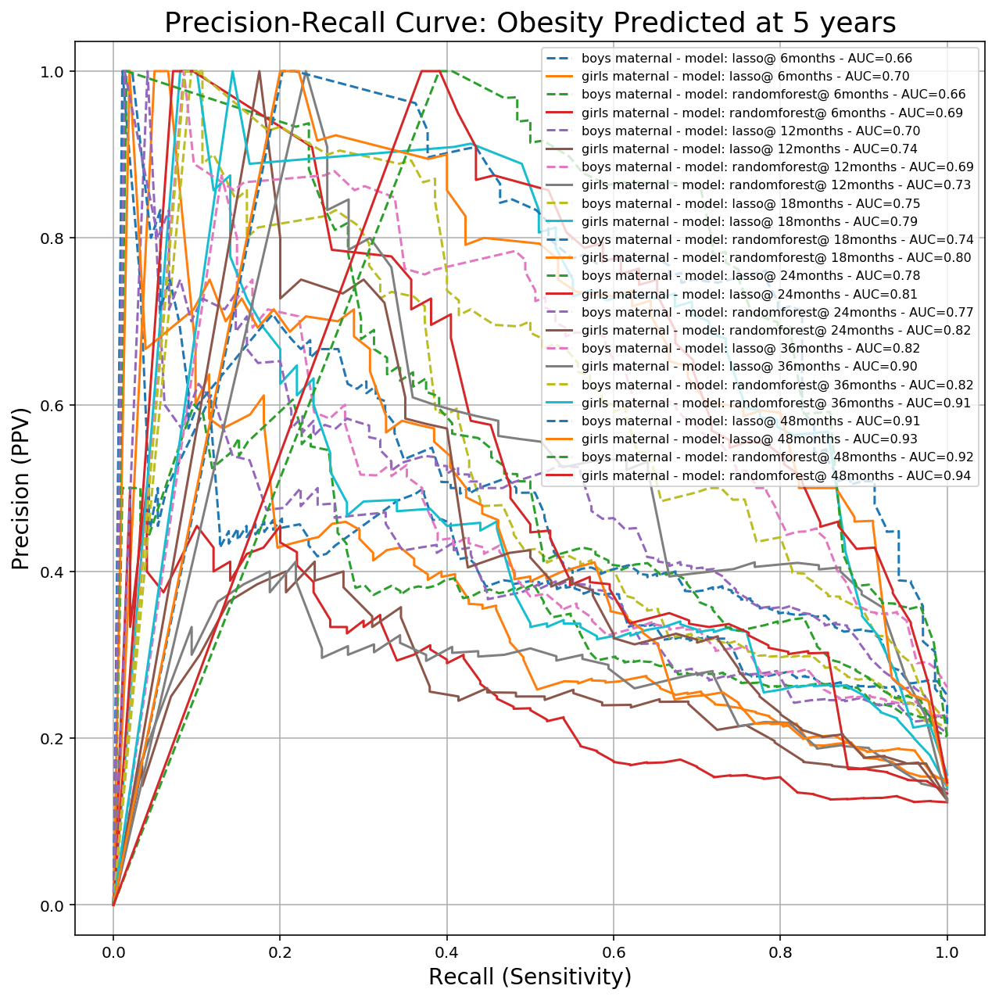

In [27]:
plt.figure(figsize=(9,9))
for ix in range(len(prec_total)):
    if any(x in titles_total[ix] for x in ('w/o vitals','Wt','no_maternal','w/o exclusions', 'BMI','gradientboost')):
        continue
    if 'girls' in titles_total[ix]:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='--', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
plt.xlabel('Recall (Sensitivity)', fontsize = 14)
plt.ylabel('Precision (PPV)', fontsize = 14)
plt.legend(fontsize = 8)
plt.axis('equal')
plt.title('Precision-Recall Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

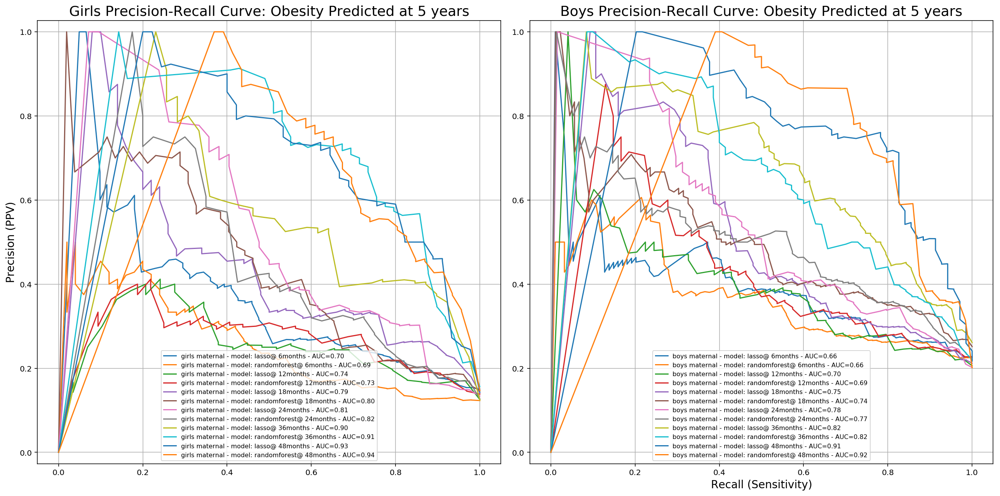

In [28]:
plt.figure(figsize=(18,9))
plt.subplot(1, 2, 1)
for ix in range(len(prec_total)):
    if any(x in titles_total[ix] for x in ('w/o vitals','Wt','no_maternal','w/o exclusions', 'BMI','gradientboost')):
        continue
    if 'girls' in titles_total[ix]:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        continue
plt.ylabel('Precision (PPV)', fontsize = 14)
plt.legend(fontsize = 8, loc=8)
plt.axis('equal')
plt.title('Girls Precision-Recall Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid()
plt.tight_layout()

plt.subplot(1, 2, 2)
for ix in range(len(prec_total)):
    if any(x in titles_total[ix] for x in ('w/o vitals','Wt','no_maternal','w/o exclusions', 'BMI','gradientboost')):
        continue
    if 'boys' in titles_total[ix]:
        plt.plot(recall_total[ix], prec_total[ix], linestyle='-', label=titles_total[ix]+' - AUC={:0.2f}'.format(auc_list[ix][0]))
    else:
        continue
plt.legend(fontsize = 8, loc=8)
plt.axis('equal')
plt.xlabel('Recall (Sensitivity)', fontsize = 14)
plt.title('Boys Precision-Recall Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

# Results for the best model each prediction age

In [29]:
df_list = []
headers=['ix','title','auc','auc ste']
for ix,(auc,title) in enumerate(zip(auc_list,titles_total)):
    df_list.append([ix,title,auc[0],auc[1]])

df = pd.DataFrame(df_list, columns=headers)
top_ix = []
for m in ['@ 6months','@ 12months','@ 18months','@ 24months','@ 36months','@ 48months']:
    for g in ['boys','girls']:
        filtered = df[(df.title.str.contains(g)) & (df.title.str.contains(m)) & (~df.title.str.contains('no_maternal'))].sort_values(by='auc', axis=0, ascending=False)
        print(filtered.head(3))
        top_ix.append([g,m,filtered.iloc[0,0]])

    ix                                          title       auc   auc ste
19  19   boys maternal - model: randomforest@ 6months  0.661492  0.015467
3    3          boys maternal - model: lasso@ 6months  0.655511  0.015622
35  35  boys maternal - model: gradientboost@ 6months  0.645629  0.014772
    ix                                              title       auc   auc ste
11  11             girls maternal - model: lasso@ 6months  0.700119  0.022386
13  13  girls maternal w/o exclusions - model: lasso@ ...  0.692385  0.020549
14  14  girls - model: lasso - Vital: BMI-latest @ 6mo...  0.688237  0.021656
    ix                                              title       auc   auc ste
51  51             boys maternal - model: lasso@ 12months  0.698681  0.017191
83  83     boys maternal - model: gradientboost@ 12months  0.696231  0.018686
55  55  boys - model: lasso - Vital: Wt-latest @ 12months  0.691071  0.025317
    ix                                            title       auc   auc ste
59  

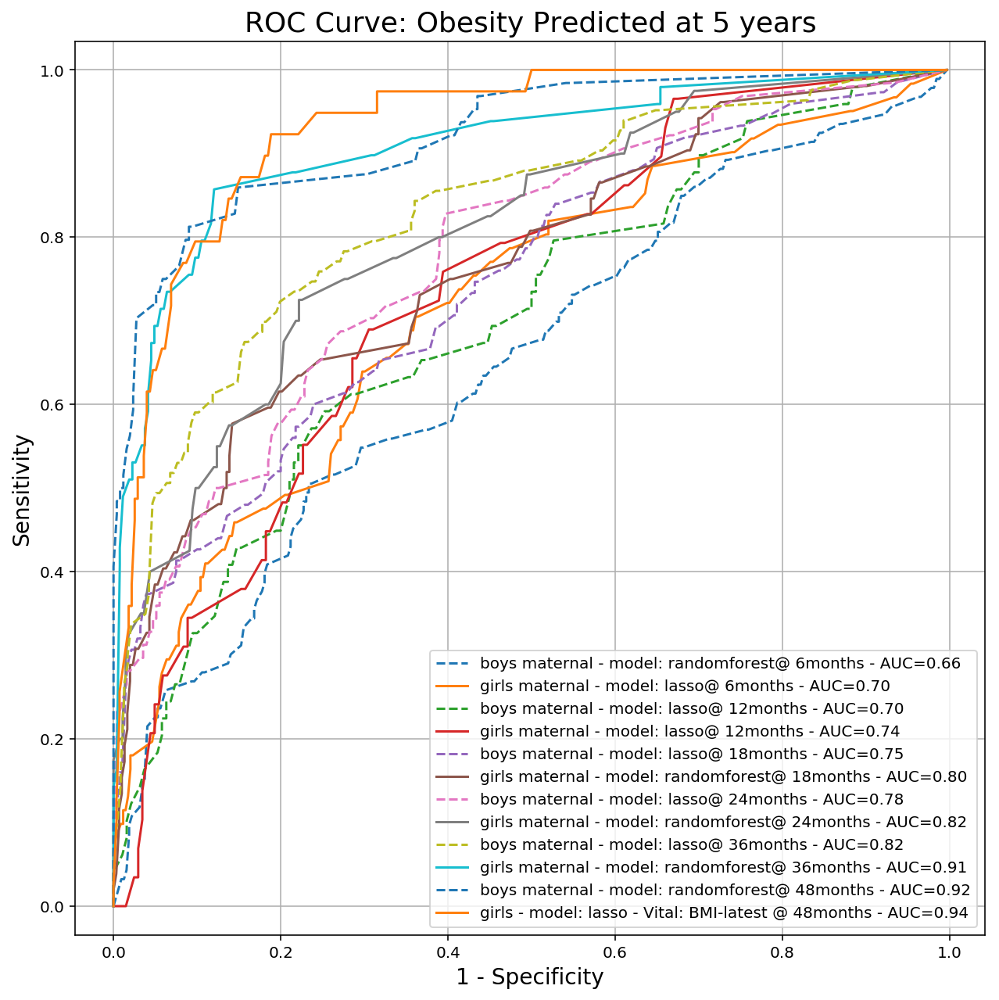

In [30]:
plt.figure(figsize=(9,9))
for l in top_ix:
    if 'girls' in titles_total[l[2]]:
        plt.plot(1- np.array(spec_total[l[2]]), np.array(recall_total[l[2]]), linestyle='-', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))
    else:
        plt.plot(1- np.array(spec_total[l[2]]), np.array(recall_total[l[2]]), linestyle='--', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))

plt.legend(fontsize = 10)
plt.xlabel('1 - Specificity', fontsize=14)
plt.ylabel('Sensitivity', fontsize=14)
plt.axis('equal')
plt.title('ROC Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid(True)
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_ROC.png', dpi=300)
plt.show()

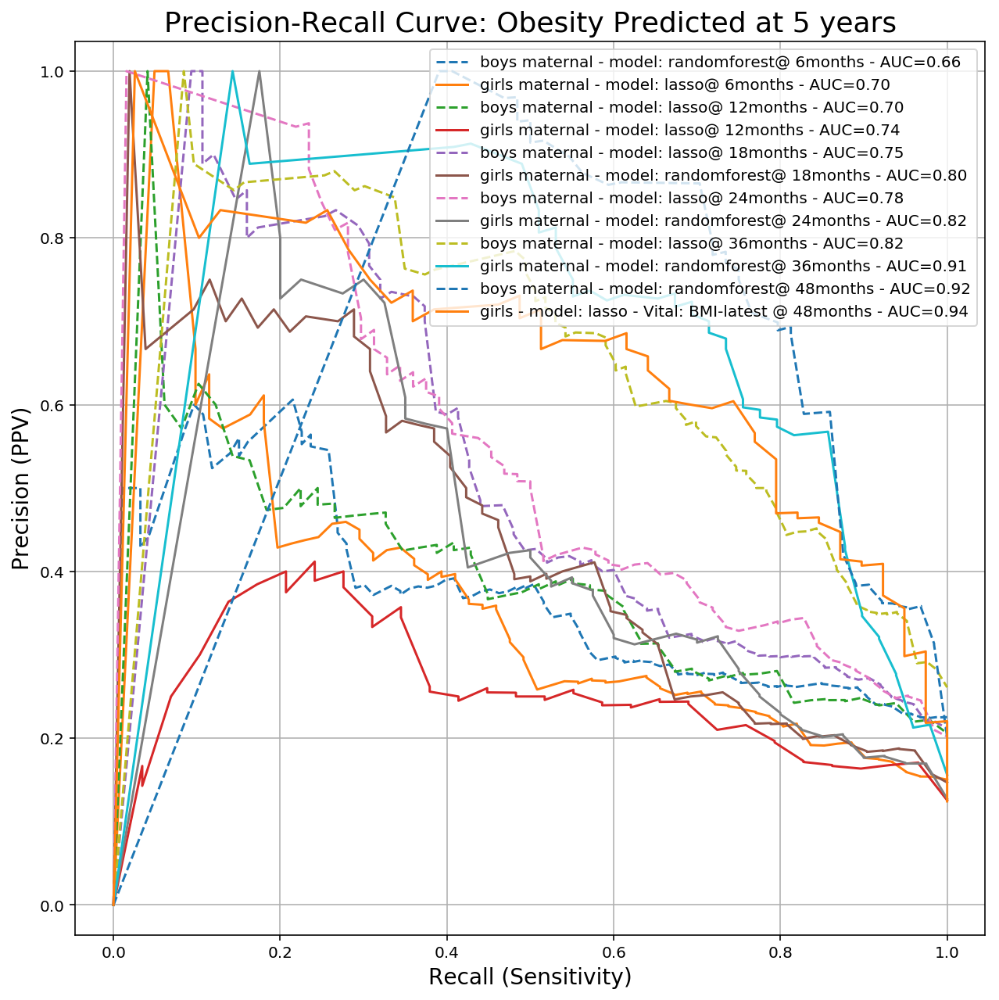

In [31]:
plt.figure(figsize=(9,9))
for l in top_ix:
    if 'girls' in titles_total[l[2]]:
        plt.plot(recall_total[l[2]], prec_total[l[2]], linestyle='-', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))
    else:
        plt.plot(recall_total[l[2]], prec_total[l[2]], linestyle='--', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))
plt.xlabel('Recall (Sensitivity)', fontsize=14)
plt.ylabel('Precision (PPV)', fontsize=14)
plt.legend(fontsize = 10)
plt.axis('equal')
plt.title('Precision-Recall Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

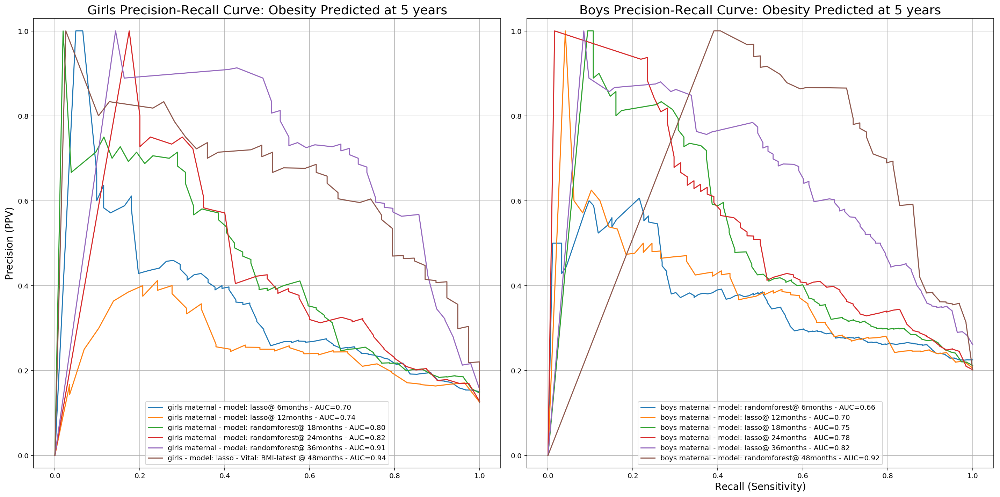

In [32]:
plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
for l in top_ix:
    if 'girls' in titles_total[l[2]]:
        plt.plot(recall_total[l[2]], prec_total[l[2]], linestyle='-', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))
    else:
        continue
plt.ylabel('Precision (PPV)', fontsize = 14)
plt.legend(fontsize=10, loc=8)
plt.axis('equal')
plt.title('Girls Precision-Recall Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid()
plt.tight_layout()

plt.subplot(1, 2, 2)
for l in top_ix:
    if 'boys' in titles_total[l[2]]:
        plt.plot(recall_total[l[2]], prec_total[l[2]], linestyle='-', label=titles_total[l[2]]+' - AUC={:0.2f}'.format(auc_list[l[2]][0]))
    else:
        continue
plt.legend(fontsize=10, loc=8)
plt.axis('equal')
plt.xlabel('Recall (Sensitivity)', fontsize = 14)
plt.title('Boys Precision-Recall Curve: Obesity Predicted at 5 years', fontsize = 18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

# Load the models and the data sets for the best models at each prediction age w/o exclusions

In [33]:
model_list_6 = pickle.load(open('../../out6/model_list.pkl', 'rb'))
model_list_12 = pickle.load(open('../../out12/model_list.pkl', 'rb'))
model_list_18 = pickle.load(open('../../out18/model_list.pkl', 'rb'))
model_list_24 = pickle.load(open('../../out24/model_list.pkl', 'rb'))
model_list_36 = pickle.load(open('../../out36/model_list.pkl', 'rb'))
model_list_48 = pickle.load(open('../../out48/model_list.pkl', 'rb'))
model_list = model_list_6 + model_list_12 + model_list_18 + model_list_24 + model_list_36 + model_list_48

boys6 = np.load('../../out6/data_transformed_randomforest_boys_maternal_no_exclusion_6_months.npz')
girls6 = np.load('../../out6/data_transformed_lasso_girls_maternal_no_exclusion_6_months.npz')
boys12 = np.load('../../out12/data_transformed_gradientboost_boys_maternal_no_exclusion_12_months.npz')
girls12 = np.load('../../out12/data_transformed_randomforest_girls_maternal_no_exclusion_12_months.npz')
boys18 = np.load('../../out18/data_transformed_gradientboost_boys_maternal_no_exclusion_18_months.npz')
girls18 = np.load('../../out18/data_transformed_randomforest_girls_maternal_no_exclusion_18_months.npz')
boys24 = np.load('../../out24/data_transformed_gradientboost_boys_maternal_no_exclusion_24_months.npz')
girls24 = np.load('../../out24/data_transformed_gradientboost_girls_maternal_no_exclusion_24_months.npz')
boys36 = np.load('../../out36/data_transformed_lasso_boys_maternal_no_exclusion_36_months.npz')
girls36 = np.load('../../out36/data_transformed_lasso_girls_maternal_no_exclusion_36_months.npz')
boys48 = np.load('../../out48/data_transformed_gradientboost_boys_maternal_no_exclusion_48_months.npz')
girls48 = np.load('../../out48/data_transformed_lasso_girls_maternal_no_exclusion_48_months.npz')


### Top Models at 24 Months

In [34]:
df_l = []
headers=['ix','title','auc','auc ste']
for ix,(auc,title) in enumerate(zip(auc_list_24,titles_total_24)):
    df_l.append([ix,title,auc[0],auc[1]])

df = pd.DataFrame(df_l, columns=headers)
top_ix_24 = []
for g in ['boys','girls']:
    filtered = df[(df.title.str.contains(g)) & (df.title.str.contains('w/o exclusions')) & (~df.title.str.contains('no_maternal'))].sort_values(by='auc', axis=0, ascending=False)
    print(filtered.head(3))
    name = filtered.iloc[0,1].replace(" maternal w/o exclusions - model: ", " ")
    top_ix_24.append([g,filtered.iloc[0,0],name])


    ix                                              title       auc   auc ste
37  37  boys maternal w/o exclusions - model: gradient...  0.767275  0.011424
5    5  boys maternal w/o exclusions - model: lasso@ 2...  0.758447  0.009043
21  21  boys maternal w/o exclusions - model: randomfo...  0.757014  0.011258
    ix                                              title       auc   auc ste
45  45  girls maternal w/o exclusions - model: gradien...  0.806009  0.010217
13  13  girls maternal w/o exclusions - model: lasso@ ...  0.805645  0.009200
29  29  girls maternal w/o exclusions - model: randomf...  0.803393  0.005738


### All Top Models

In [35]:
df_l = []
headers=['ix','title','auc','auc ste']
for ix,(auc,title) in enumerate(zip(auc_list,titles_total)):
    df_l.append([ix,title,auc[0],auc[1]])

df = pd.DataFrame(df_l, columns=headers)
top_ix = []
for age in ['@ 6','@ 12','@ 18','@ 24','@ 36','@ 48']:
    for g in ['boys','girls']:
        filtered = df[(df.title.str.contains(age)) &(df.title.str.contains(g)) & (df.title.str.contains('w/o exclusions')) & (~df.title.str.contains('no_maternal'))].sort_values(by='auc', axis=0, ascending=False)
        print(filtered.head(3))
        name = filtered.iloc[0,1].replace(" maternal w/o exclusions - model: ", " ")
        top_ix.append([age,g,filtered.iloc[0,0],name])

    ix                                              title       auc   auc ste
21  21  boys maternal w/o exclusions - model: randomfo...  0.642392  0.018267
5    5  boys maternal w/o exclusions - model: lasso@ 6...  0.633844  0.016899
37  37  boys maternal w/o exclusions - model: gradient...  0.630358  0.015649
    ix                                              title       auc   auc ste
13  13  girls maternal w/o exclusions - model: lasso@ ...  0.692385  0.020549
29  29  girls maternal w/o exclusions - model: randomf...  0.677942  0.015822
45  45  girls maternal w/o exclusions - model: gradien...  0.669962  0.017309
    ix                                              title       auc   auc ste
85  85  boys maternal w/o exclusions - model: gradient...  0.680082  0.014816
69  69  boys maternal w/o exclusions - model: randomfo...  0.672767  0.011746
53  53  boys maternal w/o exclusions - model: lasso@ 1...  0.670870  0.010762
    ix                                              title       

In [36]:
top_ix_24

[['boys', 37, 'boys gradientboost@ 24months'],
 ['girls', 45, 'girls gradientboost@ 24months']]

In [37]:
prec_24 = []
recall_24 = []
spec_24 = []
auc_24 = []

variations = ['original', 'inclusion', 'mod. inclusion']
titles_24 = [t[2]+' - '+var for t in top_ix_24 for var in variations]
headers = feature_headers.tolist()
test_sets_24 = [('boys24',boys24),('girls24',girls24)]

for test,top in zip(test_sets_24, top_ix_24):
    data = test[1]
    x1_inclusion = x1[data['ix2']][data['modeling_ix']][data['test_ix']]
    for var in variations:
        print(titles_total_24[top[1]], var)
        
        if var == 'original':
            inc_ix = np.array([True]*x1_inclusion.shape[0])
        elif var == 'inclusion':
            inc_ix = (x1_inclusion[:,feature_headers.tolist().index('MatDeliveryAge')]>=18) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal-ethnicity:HISPANIC/LATINO')]>0) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal Diagnosis:9ccs195:Ot compl bir')]==0)
        elif var == 'mod. inclusion':
            inc_ix = (x1_inclusion[:,feature_headers.tolist().index('MatDeliveryAge')]>=18) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal Diagnosis:9ccs195:Ot compl bir')]==0)
        
        if all(inc_ix == False):
            print('No valid patients')
            prec_list = [0,0,0,0,0]
            recall_list = [0,0,0,0,0]
            spec_list = [0,0,0,0,0]
            continue
            
        xtest = data['x'][data['modeling_ix']][data['test_ix']][inc_ix,:]
        ytest = data['y'][data['modeling_ix']][data['test_ix']][inc_ix]
        ytestlabel = data['ylabel'][data['modeling_ix']][data['test_ix']][inc_ix]
        mrns = data['mrns'][data['modeling_ix']][data['test_ix']][inc_ix]
        headers = data['features']
        model = model_list_24[top[1]]
        
        try:
            ytestpred = model.predict(xtest)
        except:
            continue

        fpr, tpr, thresholds = metrics.roc_curve(ytestlabel, ytestpred)
        auc_test = metrics.auc(fpr, tpr)
        auc_24.append(auc_test)
        
        operating_Thresholds = []
        operating_levels = [0, 0.0001, 0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]
        ix_level = 0

        for ix, thr in enumerate(thresholds):
            if fpr[ix] >= operating_levels[ix_level]:
                operating_Thresholds.append(thr)
                ix_level += 1
                if ix_level == len(operating_levels):
                    break

        operating_Thresholds = thresholds
        report_metrics = 'Test set metrics:\n'
        prec_list = []
        recall_list = []
        spec_list = []
        for t in operating_Thresholds:
            tp = ((ytestlabel > 0) & (ytestpred.ravel() > t)).sum()*1.0
            tn = ((ytestlabel == 0) & (ytestpred.ravel() <= t)).sum()*1.0
            fn = ((ytestlabel > 0) & (ytestpred.ravel() <= t)).sum()*1.0
            fp = ((ytestlabel == 0) & (ytestpred.ravel() > t)).sum()*1.0

            sens = tp / (tp + fn) if (tp + fn) != 0 else 0.0
            spec = tn / (tn + fp) if (tn + fp) != 0 else 0.0
            ppv = tp / (tp + fp) if (tp + fp) != 0 else 0.0
            acc = (tp + tn) / (tp + tn + fp + fn) if (tp + tn + fp + fn) != 0 else 0.0
            f1 = 2*tp / (2*tp + fp + fn) if (2*tp + fp + fn) != 0 else 0.0
            report_metrics += '@threshold:{0:4.3f}, sens:{1:4.3f}, spec:{2:4.3f}, ppv:{3:4.3f}, acc:{4:4.3f}, f1:{5:4.3f} total+:{6:4.3f}\n'.format(t, sens, spec, ppv, acc, f1, tp+fp)
            
            prec_list.append(ppv)
            recall_list.append(sens)
            spec_list.append(spec)
        prec_24.append(prec_list)
        recall_24.append(recall_list)
        spec_24.append(spec_list)
        
        print(report_metrics)

boys maternal w/o exclusions - model: gradientboost@ 24months original
Test set metrics:
@threshold:1.599, sens:0.000, spec:1.000, ppv:0.000, acc:0.791, f1:0.000 total+:0.000
@threshold:0.873, sens:0.084, spec:1.000, ppv:1.000, acc:0.808, f1:0.155 total+:13.000
@threshold:0.869, sens:0.090, spec:1.000, ppv:1.000, acc:0.810, f1:0.166 total+:14.000
@threshold:0.772, sens:0.110, spec:0.998, ppv:0.944, acc:0.812, f1:0.197 total+:18.000
@threshold:0.769, sens:0.116, spec:0.998, ppv:0.947, acc:0.814, f1:0.207 total+:19.000
@threshold:0.689, sens:0.142, spec:0.997, ppv:0.917, acc:0.818, f1:0.246 total+:24.000
@threshold:0.685, sens:0.148, spec:0.997, ppv:0.920, acc:0.819, f1:0.256 total+:25.000
@threshold:0.611, sens:0.181, spec:0.995, ppv:0.903, acc:0.825, f1:0.301 total+:31.000
@threshold:0.590, sens:0.187, spec:0.995, ppv:0.906, acc:0.826, f1:0.310 total+:32.000
@threshold:0.576, sens:0.187, spec:0.993, ppv:0.879, acc:0.825, f1:0.309 total+:33.000
@threshold:0.575, sens:0.194, spec:0.993, 

Test set metrics:
@threshold:1.282, sens:0.000, spec:1.000, ppv:0.000, acc:0.802, f1:0.000 total+:0.000
@threshold:0.766, sens:0.140, spec:1.000, ppv:1.000, acc:0.829, f1:0.245 total+:6.000
@threshold:0.685, sens:0.163, spec:1.000, ppv:1.000, acc:0.834, f1:0.280 total+:7.000
@threshold:0.572, sens:0.233, spec:0.994, ppv:0.909, acc:0.843, f1:0.370 total+:11.000
@threshold:0.450, sens:0.256, spec:0.977, ppv:0.733, acc:0.834, f1:0.379 total+:15.000
@threshold:0.374, sens:0.349, spec:0.971, ppv:0.750, acc:0.848, f1:0.476 total+:20.000
@threshold:0.373, sens:0.372, spec:0.971, ppv:0.762, acc:0.853, f1:0.500 total+:21.000
@threshold:0.370, sens:0.419, spec:0.966, ppv:0.750, acc:0.857, f1:0.537 total+:24.000
@threshold:0.334, sens:0.442, spec:0.960, ppv:0.731, acc:0.857, f1:0.551 total+:26.000
@threshold:0.329, sens:0.442, spec:0.954, ppv:0.704, acc:0.853, f1:0.543 total+:27.000
@threshold:0.328, sens:0.465, spec:0.954, ppv:0.714, acc:0.857, f1:0.563 total+:28.000
@threshold:0.301, sens:0.488

girls maternal w/o exclusions - model: gradientboost@ 24months original
Test set metrics:
@threshold:1.835, sens:0.000, spec:1.000, ppv:0.000, acc:0.844, f1:0.000 total+:0.000
@threshold:1.477, sens:0.026, spec:1.000, ppv:1.000, acc:0.848, f1:0.051 total+:3.000
@threshold:1.441, sens:0.035, spec:0.998, ppv:0.800, acc:0.848, f1:0.067 total+:5.000
@threshold:1.410, sens:0.035, spec:0.997, ppv:0.667, acc:0.846, f1:0.066 total+:6.000
@threshold:1.358, sens:0.043, spec:0.995, ppv:0.625, acc:0.846, f1:0.081 total+:8.000
@threshold:1.255, sens:0.052, spec:0.994, ppv:0.600, acc:0.846, f1:0.096 total+:10.000
@threshold:1.250, sens:0.061, spec:0.994, ppv:0.636, acc:0.848, f1:0.111 total+:11.000
@threshold:1.215, sens:0.061, spec:0.992, ppv:0.583, acc:0.846, f1:0.110 total+:12.000
@threshold:1.156, sens:0.070, spec:0.992, ppv:0.615, acc:0.848, f1:0.125 total+:13.000
@threshold:1.105, sens:0.087, spec:0.990, ppv:0.625, acc:0.849, f1:0.153 total+:16.000
@threshold:0.997, sens:0.096, spec:0.989, ppv

Test set metrics:
@threshold:1.688, sens:0.000, spec:1.000, ppv:0.000, acc:0.853, f1:0.000 total+:0.000
@threshold:1.358, sens:0.030, spec:0.984, ppv:0.250, acc:0.844, f1:0.054 total+:4.000
@threshold:1.109, sens:0.061, spec:0.979, ppv:0.333, acc:0.844, f1:0.103 total+:6.000
@threshold:0.897, sens:0.091, spec:0.974, ppv:0.375, acc:0.844, f1:0.146 total+:8.000
@threshold:0.892, sens:0.091, spec:0.969, ppv:0.333, acc:0.840, f1:0.143 total+:9.000
@threshold:0.820, sens:0.121, spec:0.958, ppv:0.333, acc:0.836, f1:0.178 total+:12.000
@threshold:0.794, sens:0.152, spec:0.953, ppv:0.357, acc:0.836, f1:0.213 total+:14.000
@threshold:0.706, sens:0.182, spec:0.943, ppv:0.353, acc:0.831, f1:0.240 total+:17.000
@threshold:0.659, sens:0.182, spec:0.938, ppv:0.333, acc:0.827, f1:0.235 total+:18.000
@threshold:0.615, sens:0.212, spec:0.927, ppv:0.333, acc:0.822, f1:0.259 total+:21.000
@threshold:0.553, sens:0.242, spec:0.922, ppv:0.348, acc:0.822, f1:0.286 total+:23.000
@threshold:0.513, sens:0.273, 

# Comparison of Mary Jo's Inclusion Criteria to Pediatric Study

<ul>
    <li>Using the best model for boys and girsl where prediction is at 24 months</li>
    <li>Original: base parameters for the pediatric study where no inclusion criteria is used </li>
    <li>Inclusion: uses Mary Jo's inclusion criteria</li>
    <ul>
        <li>Age of mother at birth is at least 18 years old</li>
        <li>No complications with the child delivery</li>
        <li>Mother is Hispanic/Latina</li>
    </ul>
    <li>Modified Inclusion: the same as above but all ethnicities are allowed</li>
</ul>

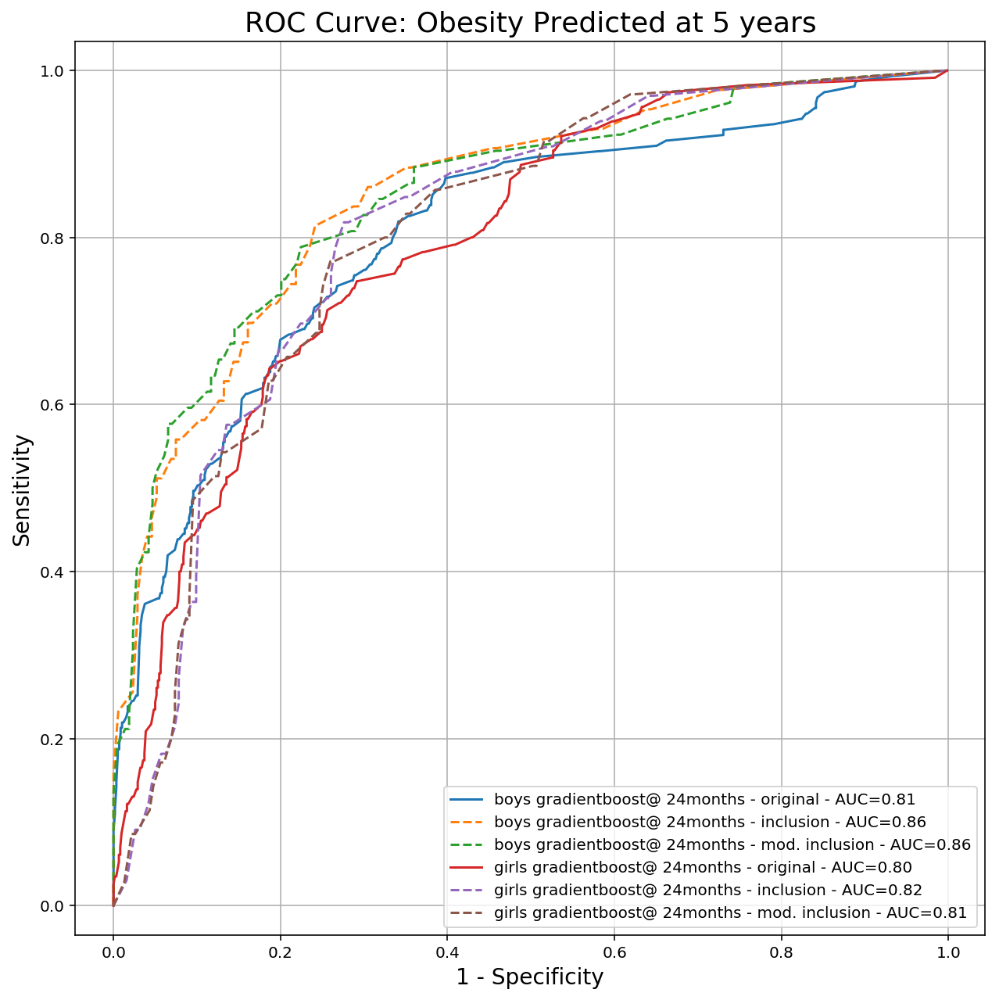

In [40]:
plt.figure(figsize=(9,9))
for i,title in enumerate(titles_24):
    if 'original' in titles_24[i].lower():
        plt.plot(1- np.array(spec_24[i]), np.array(recall_24[i]), linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_24[i]))
    elif 'inclusion mod' in titles_24[i].lower():
        plt.plot(1- np.array(spec_24[i]), np.array(recall_24[i]), linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_24[i]))
    else:
        plt.plot(1- np.array(spec_24[i]), np.array(recall_24[i]), linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_24[i]))

plt.legend(fontsize = 10)
plt.xlabel('1 - Specificity', fontsize=14)
plt.ylabel('Sensitivity', fontsize=14)
plt.axis('equal')
plt.title('ROC Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid(True)
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_ROC.png', dpi=300)
plt.show()

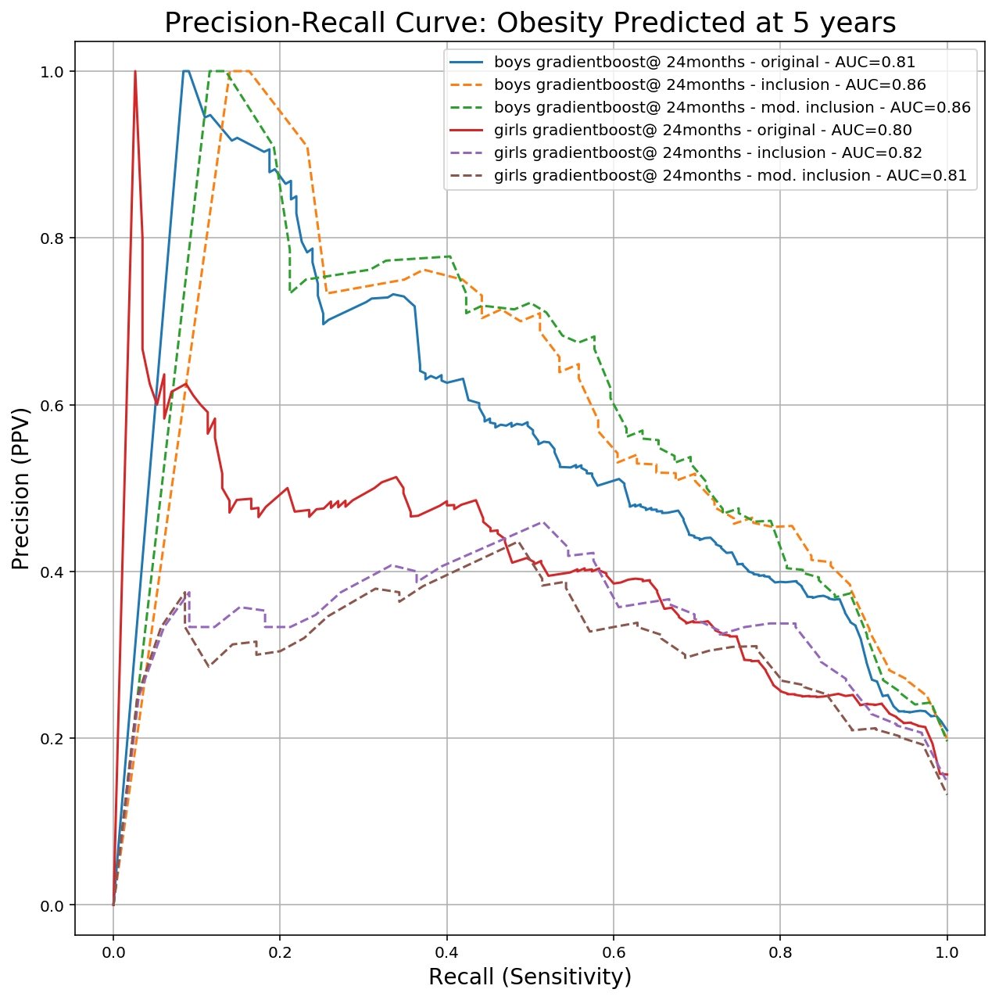

In [43]:
plt.figure(figsize=(9,9))
for i,title in enumerate(titles_24):
    if 'original' in titles_24[i].lower():
        plt.plot(recall_24[i], prec_24[i], linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_24[i]))
    elif 'inclusion mod' in titles_24[i].lower():
        plt.plot(recall_24[i], prec_24[i], linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_24[i]))
    else:
        plt.plot(recall_24[i], prec_24[i], linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_24[i]))
plt.xlabel('Recall (Sensitivity)', fontsize=14)
plt.ylabel('Precision (PPV)', fontsize=14)
plt.legend(fontsize = 10)
plt.axis('equal')
plt.title('Precision-Recall Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

# Comparison of Mary Jo's Inclusion Criteria to Pediatric Study

<ul>
    <li>Using the best model for each prediction age for boys and girls</li>
    <li>Original: base parameters for the pediatric study where no inclusion criteria is used </li>
    <li>Inclusion: uses Mary Jo's inclusion criteria</li>
    <ul>
        <li>Age of mother at birth is at least 18 years old</li>
        <li>No complications with the child delivery</li>
        <li>Mother is Hispanic/Latina</li>
    </ul>
    <li>Modified Inclusion: the same as above but all ethnicities are allowed</li>
</ul>

In [44]:
top_ix

[['@ 6', 'boys', 21, 'boys randomforest@ 6months'],
 ['@ 6', 'girls', 13, 'girls lasso@ 6months'],
 ['@ 12', 'boys', 85, 'boys gradientboost@ 12months'],
 ['@ 12', 'girls', 77, 'girls randomforest@ 12months'],
 ['@ 18', 'boys', 133, 'boys gradientboost@ 18months'],
 ['@ 18', 'girls', 125, 'girls randomforest@ 18months'],
 ['@ 24', 'boys', 181, 'boys gradientboost@ 24months'],
 ['@ 24', 'girls', 189, 'girls gradientboost@ 24months'],
 ['@ 36', 'boys', 197, 'boys lasso@ 36months'],
 ['@ 36', 'girls', 205, 'girls lasso@ 36months'],
 ['@ 48', 'boys', 277, 'boys gradientboost@ 48months'],
 ['@ 48', 'girls', 253, 'girls lasso@ 48months']]

In [45]:
prec_best = []
recall_best = []
spec_best = []
auc_best = []

test_sets_best = [('boys6',boys6),('girls6',girls6),('boys12',boys12),('girls12',girls12),('boys18',boys18),
                  ('girls18',girls18),('boys24',boys24),('girls24',girls24),('boys36',boys36),('girls36',girls36),
                  ('boys48',boys48),('girls48',girls48)]
variations = ['original', 'inclusion', 'mod. inclusion']
titles_best = [t[3]+' - '+var for t in top_ix for var in variations]
headers = feature_headers.tolist()

for test,top in zip(test_sets_best, top_ix):
    data = test[1]
    x1_inclusion = x1[data['ix2']][data['modeling_ix']][data['test_ix']]
    for var in variations:
        print(titles_total[top[2]], var)
        
        if var == 'original':
            inc_ix = np.array([True]*x1_inclusion.shape[0])
        elif var == 'inclusion':
            inc_ix = (x1_inclusion[:,feature_headers.tolist().index('MatDeliveryAge')]>=18) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal-ethnicity:HISPANIC/LATINO')]>0) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal Diagnosis:9ccs195:Ot compl bir')]==0)
        elif var == 'mod. inclusion':
            inc_ix = (x1_inclusion[:,feature_headers.tolist().index('MatDeliveryAge')]>=18) & \
                (x1_inclusion[:,feature_headers.tolist().index('Maternal Diagnosis:9ccs195:Ot compl bir')]==0)
        
        if all(inc_ix == False):
            print('No valid patients')
            prec_list = [0,0,0,0,0]
            recall_list = [0,0,0,0,0]
            spec_list = [0,0,0,0,0]
            continue
            
        xtest = data['x'][data['modeling_ix']][data['test_ix']][inc_ix,:]
        ytest = data['y'][data['modeling_ix']][data['test_ix']][inc_ix]
        ytestlabel = data['ylabel'][data['modeling_ix']][data['test_ix']][inc_ix]
        mrns = data['mrns'][data['modeling_ix']][data['test_ix']][inc_ix]
        headers = data['features']
        model = model_list[top[2]]
        
        try:
            ytestpred = model.predict(xtest)
        except:
            continue

        fpr, tpr, thresholds = metrics.roc_curve(ytestlabel, ytestpred)
        auc_test = metrics.auc(fpr, tpr)
        auc_best.append(auc_test)
        
        operating_Thresholds = []
        operating_levels = [0, 0.0001, 0.01, 0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1]
        ix_level = 0

        for ix, thr in enumerate(thresholds):
            if fpr[ix] >= operating_levels[ix_level]:
                operating_Thresholds.append(thr)
                ix_level += 1
                if ix_level == len(operating_levels):
                    break

        operating_Thresholds = thresholds
        report_metrics = 'Test set metrics:\n'
        prec_list = []
        recall_list = []
        spec_list = []
        for t in operating_Thresholds:
            tp = ((ytestlabel > 0) & (ytestpred.ravel() > t)).sum()*1.0
            tn = ((ytestlabel == 0) & (ytestpred.ravel() <= t)).sum()*1.0
            fn = ((ytestlabel > 0) & (ytestpred.ravel() <= t)).sum()*1.0
            fp = ((ytestlabel == 0) & (ytestpred.ravel() > t)).sum()*1.0

            sens = tp / (tp + fn) if (tp + fn) != 0 else 0.0
            spec = tn / (tn + fp) if (tn + fp) != 0 else 0.0
            ppv = tp / (tp + fp) if (tp + fp) != 0 else 0.0
            acc = (tp + tn) / (tp + tn + fp + fn) if (tp + tn + fp + fn) != 0 else 0.0
            f1 = 2*tp / (2*tp + fp + fn) if (2*tp + fp + fn) != 0 else 0.0
            report_metrics += '@threshold:{0:4.3f}, sens:{1:4.3f}, spec:{2:4.3f}, ppv:{3:4.3f}, acc:{4:4.3f}, f1:{5:4.3f} total+:{6:4.3f}\n'.format(t, sens, spec, ppv, acc, f1, tp+fp)
            
            prec_list.append(ppv)
            recall_list.append(sens)
            spec_list.append(spec)
        prec_best.append(prec_list)
        recall_best.append(recall_list)
        spec_best.append(spec_list)
        
        print(report_metrics)

boys maternal w/o exclusions - model: randomforest@ 6months original
Test set metrics:
@threshold:2.120, sens:0.000, spec:1.000, ppv:0.000, acc:0.800, f1:0.000 total+:0.000
@threshold:1.120, sens:0.000, spec:1.000, ppv:0.000, acc:0.800, f1:0.000 total+:0.000
@threshold:1.036, sens:0.000, spec:0.993, ppv:0.000, acc:0.795, f1:0.000 total+:3.000
@threshold:1.013, sens:0.000, spec:0.990, ppv:0.000, acc:0.793, f1:0.000 total+:4.000
@threshold:0.768, sens:0.010, spec:0.973, ppv:0.083, acc:0.781, f1:0.018 total+:12.000
@threshold:0.753, sens:0.010, spec:0.971, ppv:0.077, acc:0.779, f1:0.017 total+:13.000
@threshold:0.735, sens:0.020, spec:0.971, ppv:0.143, acc:0.781, f1:0.034 total+:14.000
@threshold:0.710, sens:0.020, spec:0.968, ppv:0.133, acc:0.779, f1:0.034 total+:15.000
@threshold:0.702, sens:0.029, spec:0.968, ppv:0.188, acc:0.781, f1:0.051 total+:16.000
@threshold:0.701, sens:0.029, spec:0.966, ppv:0.176, acc:0.779, f1:0.050 total+:17.000
@threshold:0.655, sens:0.039, spec:0.954, ppv:0

Test set metrics:
@threshold:2.120, sens:0.000, spec:1.000, ppv:0.000, acc:0.792, f1:0.000 total+:0.000
@threshold:1.120, sens:0.000, spec:1.000, ppv:0.000, acc:0.792, f1:0.000 total+:0.000
@threshold:1.044, sens:0.000, spec:0.986, ppv:0.000, acc:0.781, f1:0.000 total+:2.000
@threshold:1.013, sens:0.000, spec:0.979, ppv:0.000, acc:0.775, f1:0.000 total+:3.000
@threshold:0.735, sens:0.027, spec:0.979, ppv:0.250, acc:0.781, f1:0.049 total+:4.000
@threshold:0.701, sens:0.054, spec:0.972, ppv:0.333, acc:0.781, f1:0.093 total+:6.000
@threshold:0.655, sens:0.081, spec:0.957, ppv:0.333, acc:0.775, f1:0.130 total+:9.000
@threshold:0.648, sens:0.081, spec:0.950, ppv:0.300, acc:0.770, f1:0.128 total+:10.000
@threshold:0.627, sens:0.108, spec:0.950, ppv:0.364, acc:0.775, f1:0.167 total+:11.000
@threshold:0.619, sens:0.108, spec:0.943, ppv:0.333, acc:0.770, f1:0.163 total+:12.000
@threshold:0.592, sens:0.135, spec:0.929, ppv:0.333, acc:0.764, f1:0.192 total+:15.000
@threshold:0.563, sens:0.135, sp

girls maternal w/o exclusions - model: lasso@ 6months original
Test set metrics:
@threshold:2.392, sens:0.000, spec:1.000, ppv:0.000, acc:0.867, f1:0.000 total+:0.000
@threshold:1.392, sens:0.000, spec:1.000, ppv:0.000, acc:0.867, f1:0.000 total+:0.000
@threshold:1.234, sens:0.015, spec:0.998, ppv:0.500, acc:0.867, f1:0.029 total+:2.000
@threshold:0.933, sens:0.030, spec:0.991, ppv:0.333, acc:0.863, f1:0.055 total+:6.000
@threshold:0.916, sens:0.030, spec:0.989, ppv:0.286, acc:0.861, f1:0.054 total+:7.000
@threshold:0.903, sens:0.045, spec:0.989, ppv:0.375, acc:0.863, f1:0.080 total+:8.000
@threshold:0.851, sens:0.045, spec:0.986, ppv:0.333, acc:0.861, f1:0.079 total+:9.000
@threshold:0.819, sens:0.060, spec:0.984, ppv:0.364, acc:0.861, f1:0.103 total+:11.000
@threshold:0.770, sens:0.075, spec:0.982, ppv:0.385, acc:0.861, f1:0.125 total+:13.000
@threshold:0.764, sens:0.090, spec:0.982, ppv:0.429, acc:0.863, f1:0.148 total+:14.000
@threshold:0.747, sens:0.119, spec:0.979, ppv:0.471, acc

Test set metrics:
@threshold:2.078, sens:0.000, spec:1.000, ppv:0.000, acc:0.877, f1:0.000 total+:0.000
@threshold:1.078, sens:0.000, spec:1.000, ppv:0.000, acc:0.877, f1:0.000 total+:0.000
@threshold:0.939, sens:0.000, spec:0.995, ppv:0.000, acc:0.872, f1:0.000 total+:1.000
@threshold:0.916, sens:0.000, spec:0.989, ppv:0.000, acc:0.867, f1:0.000 total+:2.000
@threshold:0.841, sens:0.038, spec:0.989, ppv:0.333, acc:0.872, f1:0.069 total+:3.000
@threshold:0.747, sens:0.115, spec:0.984, ppv:0.500, acc:0.877, f1:0.188 total+:6.000
@threshold:0.723, sens:0.154, spec:0.984, ppv:0.571, acc:0.882, f1:0.242 total+:7.000
@threshold:0.614, sens:0.192, spec:0.978, ppv:0.556, acc:0.882, f1:0.286 total+:9.000
@threshold:0.500, sens:0.231, spec:0.973, ppv:0.545, acc:0.882, f1:0.324 total+:11.000
@threshold:0.482, sens:0.231, spec:0.968, ppv:0.500, acc:0.877, f1:0.316 total+:12.000
@threshold:0.420, sens:0.269, spec:0.930, ppv:0.350, acc:0.848, f1:0.304 total+:20.000
@threshold:0.400, sens:0.269, spe

Test set metrics:
@threshold:0.824, sens:0.000, spec:1.000, ppv:0.000, acc:0.782, f1:0.000 total+:0.000
@threshold:0.434, sens:0.021, spec:0.988, ppv:0.333, acc:0.778, f1:0.040 total+:3.000
@threshold:0.421, sens:0.021, spec:0.982, ppv:0.250, acc:0.773, f1:0.039 total+:4.000
@threshold:0.379, sens:0.043, spec:0.976, ppv:0.333, acc:0.773, f1:0.075 total+:6.000
@threshold:0.369, sens:0.043, spec:0.970, ppv:0.286, acc:0.769, f1:0.074 total+:7.000
@threshold:0.322, sens:0.064, spec:0.947, ppv:0.250, acc:0.755, f1:0.102 total+:12.000
@threshold:0.320, sens:0.064, spec:0.941, ppv:0.231, acc:0.750, f1:0.100 total+:13.000
@threshold:0.320, sens:0.085, spec:0.941, ppv:0.286, acc:0.755, f1:0.131 total+:14.000
@threshold:0.308, sens:0.085, spec:0.935, ppv:0.267, acc:0.750, f1:0.129 total+:15.000
@threshold:0.299, sens:0.106, spec:0.935, ppv:0.312, acc:0.755, f1:0.159 total+:16.000
@threshold:0.293, sens:0.106, spec:0.929, ppv:0.294, acc:0.750, f1:0.156 total+:17.000
@threshold:0.293, sens:0.128, 

girls maternal w/o exclusions - model: randomforest@ 12months original
Test set metrics:
@threshold:1.794, sens:0.000, spec:1.000, ppv:0.000, acc:0.864, f1:0.000 total+:0.000
@threshold:1.470, sens:0.013, spec:0.992, ppv:0.200, acc:0.859, f1:0.024 total+:5.000
@threshold:1.326, sens:0.025, spec:0.990, ppv:0.286, acc:0.859, f1:0.047 total+:7.000
@threshold:1.300, sens:0.038, spec:0.988, ppv:0.333, acc:0.859, f1:0.068 total+:9.000
@threshold:1.263, sens:0.051, spec:0.986, ppv:0.364, acc:0.859, f1:0.089 total+:11.000
@threshold:0.961, sens:0.063, spec:0.984, ppv:0.385, acc:0.859, f1:0.109 total+:13.000
@threshold:0.900, sens:0.076, spec:0.982, ppv:0.400, acc:0.859, f1:0.128 total+:15.000
@threshold:0.782, sens:0.089, spec:0.974, ppv:0.350, acc:0.854, f1:0.141 total+:20.000
@threshold:0.779, sens:0.089, spec:0.972, ppv:0.333, acc:0.852, f1:0.140 total+:21.000
@threshold:0.753, sens:0.101, spec:0.968, ppv:0.333, acc:0.851, f1:0.155 total+:24.000
@threshold:0.721, sens:0.101, spec:0.966, ppv

Test set metrics:
@threshold:1.794, sens:0.000, spec:1.000, ppv:0.000, acc:0.861, f1:0.000 total+:0.000
@threshold:1.324, sens:0.028, spec:1.000, ppv:1.000, acc:0.865, f1:0.054 total+:1.000
@threshold:1.263, sens:0.056, spec:0.996, ppv:0.667, acc:0.865, f1:0.103 total+:3.000
@threshold:0.961, sens:0.083, spec:0.996, ppv:0.750, acc:0.869, f1:0.150 total+:4.000
@threshold:0.933, sens:0.083, spec:0.991, ppv:0.600, acc:0.865, f1:0.146 total+:5.000
@threshold:0.782, sens:0.111, spec:0.987, ppv:0.571, acc:0.865, f1:0.186 total+:7.000
@threshold:0.779, sens:0.111, spec:0.982, ppv:0.500, acc:0.861, f1:0.182 total+:8.000
@threshold:0.666, sens:0.139, spec:0.951, ppv:0.312, acc:0.838, f1:0.192 total+:16.000
@threshold:0.665, sens:0.139, spec:0.946, ppv:0.294, acc:0.834, f1:0.189 total+:17.000
@threshold:0.638, sens:0.167, spec:0.942, ppv:0.316, acc:0.834, f1:0.218 total+:19.000
@threshold:0.607, sens:0.194, spec:0.937, ppv:0.333, acc:0.834, f1:0.246 total+:21.000
@threshold:0.552, sens:0.222, sp

boys maternal w/o exclusions - model: gradientboost@ 18months original
Test set metrics:
@threshold:0.951, sens:0.000, spec:1.000, ppv:0.000, acc:0.759, f1:0.000 total+:0.000
@threshold:0.783, sens:0.025, spec:1.000, ppv:1.000, acc:0.766, f1:0.049 total+:4.000
@threshold:0.682, sens:0.031, spec:0.998, ppv:0.833, acc:0.766, f1:0.061 total+:6.000
@threshold:0.613, sens:0.031, spec:0.996, ppv:0.714, acc:0.764, f1:0.060 total+:7.000
@threshold:0.568, sens:0.038, spec:0.992, ppv:0.600, acc:0.762, f1:0.071 total+:10.000
@threshold:0.528, sens:0.063, spec:0.990, ppv:0.667, acc:0.767, f1:0.115 total+:15.000
@threshold:0.523, sens:0.069, spec:0.990, ppv:0.688, acc:0.769, f1:0.126 total+:16.000
@threshold:0.492, sens:0.082, spec:0.988, ppv:0.684, acc:0.770, f1:0.146 total+:19.000
@threshold:0.487, sens:0.088, spec:0.988, ppv:0.700, acc:0.772, f1:0.156 total+:20.000
@threshold:0.468, sens:0.088, spec:0.986, ppv:0.667, acc:0.770, f1:0.156 total+:21.000
@threshold:0.449, sens:0.094, spec:0.984, ppv

Test set metrics:
@threshold:0.848, sens:0.000, spec:1.000, ppv:0.000, acc:0.740, f1:0.000 total+:0.000
@threshold:0.794, sens:0.019, spec:1.000, ppv:1.000, acc:0.745, f1:0.036 total+:1.000
@threshold:0.577, sens:0.037, spec:0.994, ppv:0.667, acc:0.745, f1:0.070 total+:3.000
@threshold:0.468, sens:0.111, spec:0.987, ppv:0.750, acc:0.760, f1:0.194 total+:8.000
@threshold:0.426, sens:0.130, spec:0.974, ppv:0.636, acc:0.755, f1:0.215 total+:11.000
@threshold:0.413, sens:0.130, spec:0.968, ppv:0.583, acc:0.750, f1:0.212 total+:12.000
@threshold:0.377, sens:0.148, spec:0.961, ppv:0.571, acc:0.750, f1:0.235 total+:14.000
@threshold:0.375, sens:0.148, spec:0.955, ppv:0.533, acc:0.745, f1:0.232 total+:15.000
@threshold:0.371, sens:0.167, spec:0.955, ppv:0.562, acc:0.750, f1:0.257 total+:16.000
@threshold:0.337, sens:0.204, spec:0.948, ppv:0.579, acc:0.755, f1:0.301 total+:19.000
@threshold:0.330, sens:0.222, spec:0.948, ppv:0.600, acc:0.760, f1:0.324 total+:20.000
@threshold:0.318, sens:0.222,

girls maternal w/o exclusions - model: randomforest@ 18months original
Test set metrics:
@threshold:2.131, sens:0.000, spec:1.000, ppv:0.000, acc:0.865, f1:0.000 total+:0.000
@threshold:1.856, sens:0.022, spec:1.000, ppv:1.000, acc:0.868, f1:0.043 total+:2.000
@threshold:1.751, sens:0.033, spec:1.000, ppv:1.000, acc:0.870, f1:0.065 total+:3.000
@threshold:1.719, sens:0.033, spec:0.998, ppv:0.750, acc:0.868, f1:0.064 total+:4.000
@threshold:1.685, sens:0.044, spec:0.998, ppv:0.800, acc:0.870, f1:0.084 total+:5.000
@threshold:1.468, sens:0.044, spec:0.997, ppv:0.667, acc:0.868, f1:0.083 total+:6.000
@threshold:1.450, sens:0.056, spec:0.997, ppv:0.714, acc:0.870, f1:0.103 total+:7.000
@threshold:1.409, sens:0.056, spec:0.995, ppv:0.625, acc:0.868, f1:0.102 total+:8.000
@threshold:1.363, sens:0.067, spec:0.995, ppv:0.667, acc:0.870, f1:0.121 total+:9.000
@threshold:1.324, sens:0.067, spec:0.993, ppv:0.600, acc:0.868, f1:0.120 total+:10.000
@threshold:1.293, sens:0.078, spec:0.993, ppv:0.63

Test set metrics:
@threshold:2.131, sens:0.000, spec:1.000, ppv:0.000, acc:0.873, f1:0.000 total+:0.000
@threshold:1.896, sens:0.034, spec:1.000, ppv:1.000, acc:0.878, f1:0.067 total+:1.000
@threshold:1.151, sens:0.069, spec:0.985, ppv:0.400, acc:0.869, f1:0.118 total+:5.000
@threshold:0.967, sens:0.241, spec:0.980, ppv:0.636, acc:0.886, f1:0.350 total+:11.000
@threshold:0.885, sens:0.276, spec:0.975, ppv:0.615, acc:0.886, f1:0.381 total+:13.000
@threshold:0.811, sens:0.276, spec:0.970, ppv:0.571, acc:0.882, f1:0.372 total+:14.000
@threshold:0.801, sens:0.310, spec:0.965, ppv:0.562, acc:0.882, f1:0.400 total+:16.000
@threshold:0.769, sens:0.310, spec:0.960, ppv:0.529, acc:0.878, f1:0.391 total+:17.000
@threshold:0.762, sens:0.345, spec:0.960, ppv:0.556, acc:0.882, f1:0.426 total+:18.000
@threshold:0.752, sens:0.345, spec:0.955, ppv:0.526, acc:0.878, f1:0.417 total+:19.000
@threshold:0.726, sens:0.379, spec:0.955, ppv:0.550, acc:0.882, f1:0.449 total+:20.000
@threshold:0.708, sens:0.448

Test set metrics:
@threshold:1.282, sens:0.000, spec:1.000, ppv:0.000, acc:0.802, f1:0.000 total+:0.000
@threshold:0.766, sens:0.140, spec:1.000, ppv:1.000, acc:0.829, f1:0.245 total+:6.000
@threshold:0.685, sens:0.163, spec:1.000, ppv:1.000, acc:0.834, f1:0.280 total+:7.000
@threshold:0.572, sens:0.233, spec:0.994, ppv:0.909, acc:0.843, f1:0.370 total+:11.000
@threshold:0.450, sens:0.256, spec:0.977, ppv:0.733, acc:0.834, f1:0.379 total+:15.000
@threshold:0.374, sens:0.349, spec:0.971, ppv:0.750, acc:0.848, f1:0.476 total+:20.000
@threshold:0.373, sens:0.372, spec:0.971, ppv:0.762, acc:0.853, f1:0.500 total+:21.000
@threshold:0.370, sens:0.419, spec:0.966, ppv:0.750, acc:0.857, f1:0.537 total+:24.000
@threshold:0.334, sens:0.442, spec:0.960, ppv:0.731, acc:0.857, f1:0.551 total+:26.000
@threshold:0.329, sens:0.442, spec:0.954, ppv:0.704, acc:0.853, f1:0.543 total+:27.000
@threshold:0.328, sens:0.465, spec:0.954, ppv:0.714, acc:0.857, f1:0.563 total+:28.000
@threshold:0.301, sens:0.488

girls maternal w/o exclusions - model: gradientboost@ 24months original
Test set metrics:
@threshold:1.835, sens:0.000, spec:1.000, ppv:0.000, acc:0.844, f1:0.000 total+:0.000
@threshold:1.477, sens:0.026, spec:1.000, ppv:1.000, acc:0.848, f1:0.051 total+:3.000
@threshold:1.441, sens:0.035, spec:0.998, ppv:0.800, acc:0.848, f1:0.067 total+:5.000
@threshold:1.410, sens:0.035, spec:0.997, ppv:0.667, acc:0.846, f1:0.066 total+:6.000
@threshold:1.358, sens:0.043, spec:0.995, ppv:0.625, acc:0.846, f1:0.081 total+:8.000
@threshold:1.255, sens:0.052, spec:0.994, ppv:0.600, acc:0.846, f1:0.096 total+:10.000
@threshold:1.250, sens:0.061, spec:0.994, ppv:0.636, acc:0.848, f1:0.111 total+:11.000
@threshold:1.215, sens:0.061, spec:0.992, ppv:0.583, acc:0.846, f1:0.110 total+:12.000
@threshold:1.156, sens:0.070, spec:0.992, ppv:0.615, acc:0.848, f1:0.125 total+:13.000
@threshold:1.105, sens:0.087, spec:0.990, ppv:0.625, acc:0.849, f1:0.153 total+:16.000
@threshold:0.997, sens:0.096, spec:0.989, ppv

Test set metrics:
@threshold:1.688, sens:0.000, spec:1.000, ppv:0.000, acc:0.853, f1:0.000 total+:0.000
@threshold:1.358, sens:0.030, spec:0.984, ppv:0.250, acc:0.844, f1:0.054 total+:4.000
@threshold:1.109, sens:0.061, spec:0.979, ppv:0.333, acc:0.844, f1:0.103 total+:6.000
@threshold:0.897, sens:0.091, spec:0.974, ppv:0.375, acc:0.844, f1:0.146 total+:8.000
@threshold:0.892, sens:0.091, spec:0.969, ppv:0.333, acc:0.840, f1:0.143 total+:9.000
@threshold:0.820, sens:0.121, spec:0.958, ppv:0.333, acc:0.836, f1:0.178 total+:12.000
@threshold:0.794, sens:0.152, spec:0.953, ppv:0.357, acc:0.836, f1:0.213 total+:14.000
@threshold:0.706, sens:0.182, spec:0.943, ppv:0.353, acc:0.831, f1:0.240 total+:17.000
@threshold:0.659, sens:0.182, spec:0.938, ppv:0.333, acc:0.827, f1:0.235 total+:18.000
@threshold:0.615, sens:0.212, spec:0.927, ppv:0.333, acc:0.822, f1:0.259 total+:21.000
@threshold:0.553, sens:0.242, spec:0.922, ppv:0.348, acc:0.822, f1:0.286 total+:23.000
@threshold:0.513, sens:0.273, 

Test set metrics:
@threshold:2.999, sens:0.000, spec:1.000, ppv:0.000, acc:0.777, f1:0.000 total+:0.000
@threshold:1.577, sens:0.079, spec:1.000, ppv:1.000, acc:0.794, f1:0.147 total+:16.000
@threshold:1.518, sens:0.084, spec:1.000, ppv:1.000, acc:0.796, f1:0.155 total+:17.000
@threshold:1.195, sens:0.163, spec:0.999, ppv:0.971, acc:0.812, f1:0.280 total+:34.000
@threshold:1.170, sens:0.168, spec:0.999, ppv:0.971, acc:0.813, f1:0.287 total+:35.000
@threshold:1.151, sens:0.168, spec:0.997, ppv:0.944, acc:0.812, f1:0.286 total+:36.000
@threshold:1.143, sens:0.173, spec:0.997, ppv:0.946, acc:0.813, f1:0.293 total+:37.000
@threshold:1.039, sens:0.203, spec:0.996, ppv:0.932, acc:0.819, f1:0.333 total+:44.000
@threshold:1.038, sens:0.208, spec:0.996, ppv:0.933, acc:0.820, f1:0.340 total+:45.000
@threshold:1.032, sens:0.213, spec:0.994, ppv:0.915, acc:0.820, f1:0.345 total+:47.000
@threshold:1.027, sens:0.218, spec:0.994, ppv:0.917, acc:0.821, f1:0.352 total+:48.000
@threshold:1.018, sens:0.2

Test set metrics:
@threshold:2.393, sens:0.000, spec:1.000, ppv:0.000, acc:0.785, f1:0.000 total+:0.000
@threshold:1.074, sens:0.146, spec:1.000, ppv:1.000, acc:0.816, f1:0.255 total+:7.000
@threshold:1.027, sens:0.167, spec:0.994, ppv:0.889, acc:0.816, f1:0.281 total+:9.000
@threshold:1.018, sens:0.188, spec:0.989, ppv:0.818, acc:0.816, f1:0.305 total+:11.000
@threshold:0.974, sens:0.208, spec:0.983, ppv:0.769, acc:0.816, f1:0.328 total+:13.000
@threshold:0.916, sens:0.229, spec:0.977, ppv:0.733, acc:0.816, f1:0.349 total+:15.000
@threshold:0.915, sens:0.250, spec:0.977, ppv:0.750, acc:0.821, f1:0.375 total+:16.000
@threshold:0.857, sens:0.250, spec:0.971, ppv:0.706, acc:0.816, f1:0.369 total+:17.000
@threshold:0.727, sens:0.271, spec:0.954, ppv:0.619, acc:0.807, f1:0.377 total+:21.000
@threshold:0.702, sens:0.312, spec:0.949, ppv:0.625, acc:0.812, f1:0.417 total+:24.000
@threshold:0.665, sens:0.333, spec:0.937, ppv:0.593, acc:0.807, f1:0.427 total+:27.000
@threshold:0.664, sens:0.333

girls maternal w/o exclusions - model: lasso@ 36months original
Test set metrics:
@threshold:3.079, sens:0.000, spec:1.000, ppv:0.000, acc:0.857, f1:0.000 total+:0.000
@threshold:2.047, sens:0.069, spec:1.000, ppv:1.000, acc:0.867, f1:0.129 total+:9.000
@threshold:1.979, sens:0.077, spec:1.000, ppv:1.000, acc:0.868, f1:0.143 total+:10.000
@threshold:1.459, sens:0.223, spec:0.999, ppv:0.967, acc:0.888, f1:0.362 total+:30.000
@threshold:1.443, sens:0.231, spec:0.997, ppv:0.938, acc:0.888, f1:0.370 total+:32.000
@threshold:1.413, sens:0.246, spec:0.996, ppv:0.914, acc:0.889, f1:0.388 total+:35.000
@threshold:1.407, sens:0.254, spec:0.996, ppv:0.917, acc:0.890, f1:0.398 total+:36.000
@threshold:1.322, sens:0.292, spec:0.995, ppv:0.905, acc:0.895, f1:0.442 total+:42.000
@threshold:1.309, sens:0.300, spec:0.995, ppv:0.907, acc:0.896, f1:0.451 total+:43.000
@threshold:1.278, sens:0.308, spec:0.994, ppv:0.889, acc:0.896, f1:0.457 total+:45.000
@threshold:1.234, sens:0.315, spec:0.992, ppv:0.87

Test set metrics:
@threshold:2.294, sens:0.000, spec:1.000, ppv:0.000, acc:0.895, f1:0.000 total+:0.000
@threshold:1.322, sens:0.240, spec:1.000, ppv:1.000, acc:0.921, f1:0.387 total+:6.000
@threshold:1.180, sens:0.280, spec:0.995, ppv:0.875, acc:0.921, f1:0.424 total+:8.000
@threshold:1.037, sens:0.360, spec:0.991, ppv:0.818, acc:0.925, f1:0.500 total+:11.000
@threshold:0.989, sens:0.400, spec:0.986, ppv:0.769, acc:0.925, f1:0.526 total+:13.000
@threshold:0.971, sens:0.400, spec:0.981, ppv:0.714, acc:0.921, f1:0.513 total+:14.000
@threshold:0.958, sens:0.440, spec:0.981, ppv:0.733, acc:0.925, f1:0.550 total+:15.000
@threshold:0.922, sens:0.480, spec:0.977, ppv:0.706, acc:0.925, f1:0.571 total+:17.000
@threshold:0.896, sens:0.520, spec:0.977, ppv:0.722, acc:0.929, f1:0.605 total+:18.000
@threshold:0.833, sens:0.600, spec:0.972, ppv:0.714, acc:0.933, f1:0.652 total+:21.000
@threshold:0.745, sens:0.640, spec:0.967, ppv:0.696, acc:0.933, f1:0.667 total+:23.000
@threshold:0.726, sens:0.680

Test set metrics:
@threshold:2.923, sens:0.000, spec:1.000, ppv:0.000, acc:0.821, f1:0.000 total+:0.000
@threshold:1.823, sens:0.125, spec:1.000, ppv:1.000, acc:0.844, f1:0.222 total+:5.000
@threshold:1.555, sens:0.150, spec:1.000, ppv:1.000, acc:0.848, f1:0.261 total+:6.000
@threshold:1.213, sens:0.175, spec:0.995, ppv:0.875, acc:0.848, f1:0.292 total+:8.000
@threshold:0.886, sens:0.200, spec:0.984, ppv:0.727, acc:0.844, f1:0.314 total+:11.000
@threshold:0.884, sens:0.200, spec:0.978, ppv:0.667, acc:0.839, f1:0.308 total+:12.000
@threshold:0.845, sens:0.225, spec:0.973, ppv:0.643, acc:0.839, f1:0.333 total+:14.000
@threshold:0.674, sens:0.300, spec:0.967, ppv:0.667, acc:0.848, f1:0.414 total+:18.000
@threshold:0.622, sens:0.325, spec:0.951, ppv:0.591, acc:0.839, f1:0.419 total+:22.000
@threshold:0.607, sens:0.350, spec:0.946, ppv:0.583, acc:0.839, f1:0.438 total+:24.000
@threshold:0.598, sens:0.375, spec:0.946, ppv:0.600, acc:0.844, f1:0.462 total+:25.000
@threshold:0.578, sens:0.375,

girls maternal w/o exclusions - model: lasso@ 48months original
Test set metrics:
@threshold:4.303, sens:0.000, spec:1.000, ppv:0.000, acc:0.831, f1:0.000 total+:0.000
@threshold:1.952, sens:0.112, spec:1.000, ppv:1.000, acc:0.850, f1:0.202 total+:21.000
@threshold:1.888, sens:0.118, spec:1.000, ppv:1.000, acc:0.851, f1:0.211 total+:22.000
@threshold:1.731, sens:0.193, spec:0.999, ppv:0.973, acc:0.863, f1:0.321 total+:37.000
@threshold:1.720, sens:0.198, spec:0.999, ppv:0.974, acc:0.864, f1:0.329 total+:38.000
@threshold:1.547, sens:0.225, spec:0.998, ppv:0.955, acc:0.867, f1:0.364 total+:44.000
@threshold:1.533, sens:0.230, spec:0.998, ppv:0.956, acc:0.868, f1:0.371 total+:45.000
@threshold:1.335, sens:0.289, spec:0.997, ppv:0.947, acc:0.877, f1:0.443 total+:57.000
@threshold:1.326, sens:0.294, spec:0.996, ppv:0.932, acc:0.877, f1:0.447 total+:59.000
@threshold:1.325, sens:0.294, spec:0.995, ppv:0.917, acc:0.876, f1:0.445 total+:60.000
@threshold:1.306, sens:0.299, spec:0.995, ppv:0.9

Test set metrics:
@threshold:2.987, sens:0.000, spec:1.000, ppv:0.000, acc:0.842, f1:0.000 total+:0.000
@threshold:1.268, sens:0.243, spec:1.000, ppv:1.000, acc:0.880, f1:0.391 total+:9.000
@threshold:1.252, sens:0.270, spec:1.000, ppv:1.000, acc:0.885, f1:0.426 total+:10.000
@threshold:1.173, sens:0.324, spec:0.995, ppv:0.923, acc:0.889, f1:0.480 total+:13.000
@threshold:1.147, sens:0.351, spec:0.995, ppv:0.929, acc:0.893, f1:0.510 total+:14.000
@threshold:1.024, sens:0.378, spec:0.990, ppv:0.875, acc:0.893, f1:0.528 total+:16.000
@threshold:1.021, sens:0.405, spec:0.990, ppv:0.882, acc:0.897, f1:0.556 total+:17.000
@threshold:0.997, sens:0.432, spec:0.985, ppv:0.842, acc:0.897, f1:0.571 total+:19.000
@threshold:0.965, sens:0.459, spec:0.985, ppv:0.850, acc:0.902, f1:0.596 total+:20.000
@threshold:0.918, sens:0.459, spec:0.980, ppv:0.810, acc:0.897, f1:0.586 total+:21.000
@threshold:0.836, sens:0.486, spec:0.980, ppv:0.818, acc:0.902, f1:0.610 total+:22.000
@threshold:0.762, sens:0.51

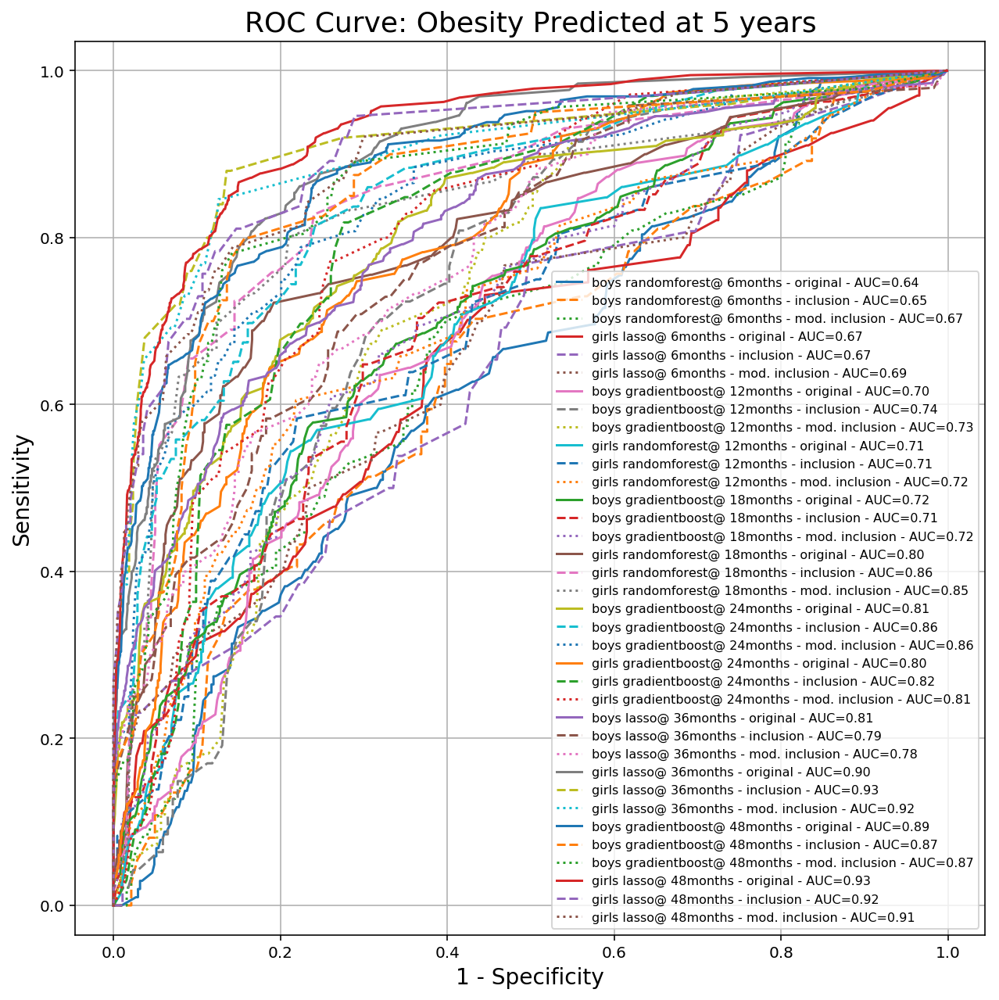

In [46]:
plt.figure(figsize=(9,9))
for i,title in enumerate(titles_best):
    if 'original' in titles_best[i].lower():
        plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    elif 'mod.' in titles_best[i].lower():
        plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))

plt.legend(fontsize = 8)
plt.xlabel('1 - Specificity', fontsize=14)
plt.ylabel('Sensitivity', fontsize=14)
plt.axis('equal')
plt.title('ROC Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid(True)
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_ROC.png', dpi=300)
plt.show()

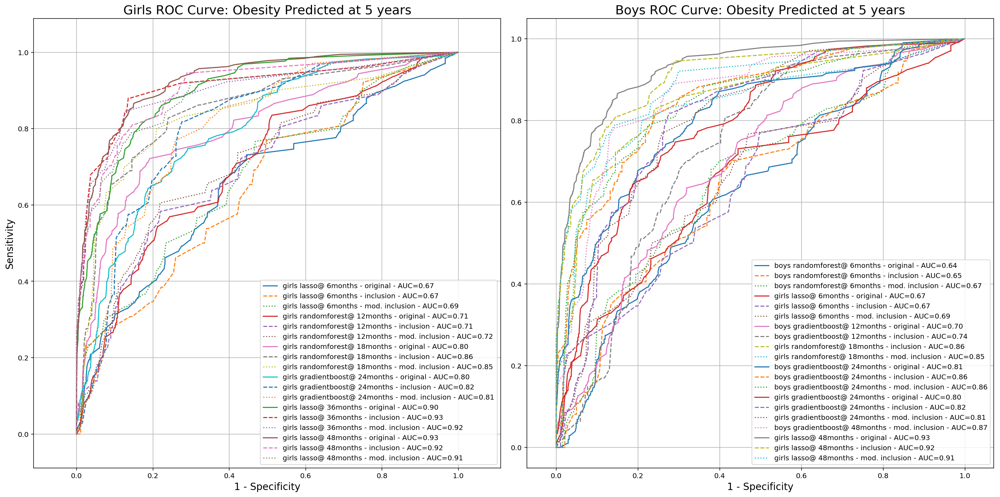

In [47]:
plt.figure(figsize=(20,10))

plt.subplot(1, 2, 1)
for i,title in enumerate(titles_best):
    if 'girls' in titles_best[i]:
        if 'original' in titles_best[i].lower():
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        elif 'mod.' in titles_best[i].lower():
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        else:
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        continue
plt.legend(fontsize = 10)
plt.ylabel('Sensitivity', fontsize=14)
plt.xlabel('1 - Specificity', fontsize=14)
plt.axis('equal')
plt.title('Girls ROC Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid(True)
plt.tight_layout()        

plt.subplot(1, 2, 2)
for i,title in enumerate(titles_best):
    if 'boys' in titles_total[i]:
        if 'original' in titles_best[i].lower():
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        elif 'mod.' in titles_best[i].lower():
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        else:
            plt.plot(1- np.array(spec_best[i]), np.array(recall_best[i]), linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        continue
plt.legend(fontsize = 10)
plt.xlabel('1 - Specificity', fontsize=14)
plt.axis('equal')
plt.title('Boys ROC Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid(True)
plt.tight_layout()        

# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

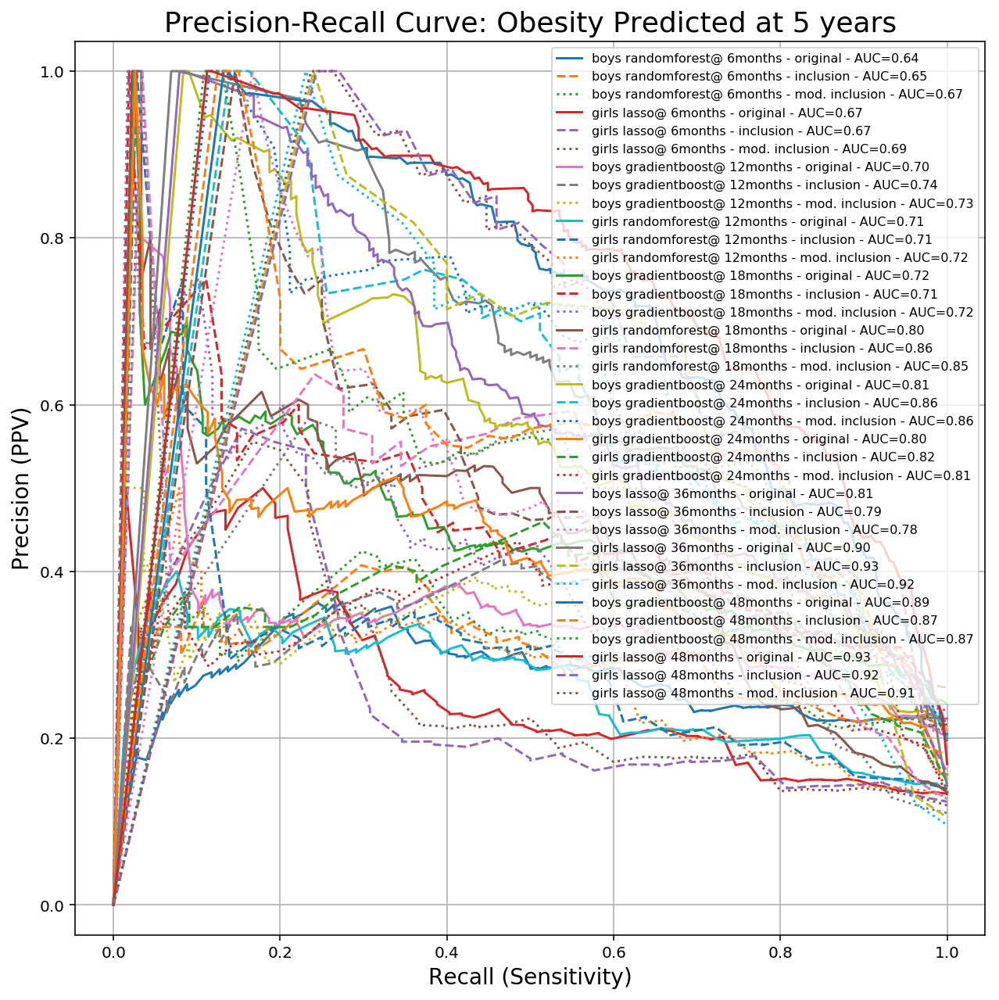

In [48]:
plt.figure(figsize=(9,9))
for i,title in enumerate(titles_best):
    if 'original' in titles_best[i].lower():
        plt.plot(recall_best[i], prec_best[i], linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    elif 'mod.' in titles_best[i].lower():
        plt.plot(recall_best[i], prec_best[i], linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        plt.plot(recall_best[i], prec_best[i], linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
plt.xlabel('Recall (Sensitivity)', fontsize=14)
plt.ylabel('Precision (PPV)', fontsize=14)
plt.legend(fontsize=8, loc='upper right')
plt.axis('equal')
plt.title('Precision-Recall Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid()
plt.tight_layout()
# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

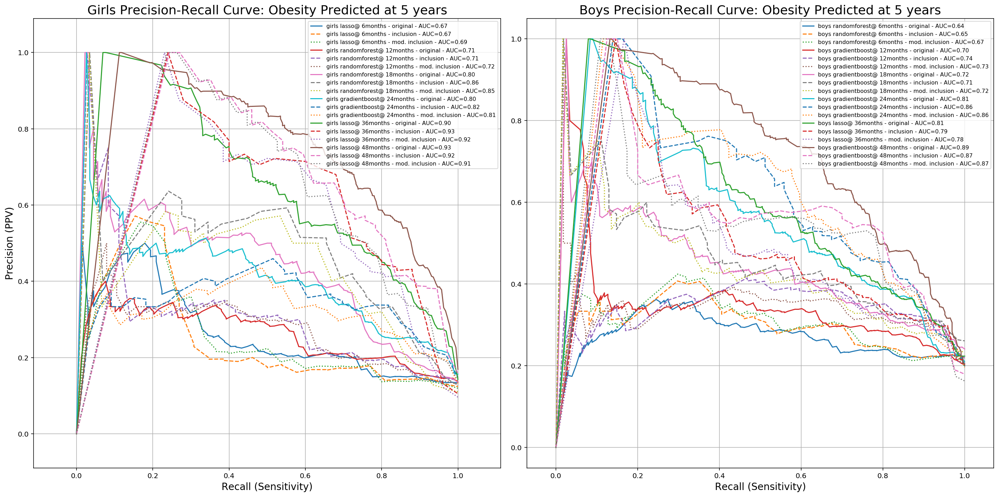

In [49]:
plt.figure(figsize=(20,10))

plt.subplot(1, 2, 1)
for i,title in enumerate(titles_best):
    if 'girls' in titles_best[i]:
        if 'original' in titles_best[i].lower():
            plt.plot(recall_best[i], prec_best[i], linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        elif 'mod.' in titles_best[i].lower():
            plt.plot(recall_best[i], prec_best[i], linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        else:
            plt.plot(recall_best[i], prec_best[i], linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        continue
plt.ylabel('Precision (PPV)', fontsize=14)
plt.xlabel('Recall (Sensitivity)', fontsize=14)

plt.legend(fontsize = 8)
plt.axis('equal')
plt.title('Girls Precision-Recall Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid()
plt.tight_layout()        

plt.subplot(1, 2, 2)
for i,title in enumerate(titles_best):
    if 'boys' in titles_best[i]:
        if 'original' in titles_best[i].lower():
            plt.plot(recall_best[i], prec_best[i], linestyle='-', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        elif 'mod.' in titles_best[i].lower():
            plt.plot(recall_best[i], prec_best[i], linestyle=':', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
        else:
            plt.plot(recall_best[i], prec_best[i], linestyle='--', label=title+' - AUC={:0.2f}'.format(auc_best[i]))
    else:
        continue
plt.xlabel('Recall (Sensitivity)', fontsize=14)
plt.legend(fontsize = 8)
plt.axis('equal')
plt.title('Boys Precision-Recall Curve: Obesity Predicted at 5 years', fontsize=18)
plt.grid()
plt.tight_layout()      

# plt.savefig(newdir+'/Pediatric_Girls_PR.png', dpi=300)
plt.show()

# Next Steps
<ul>
    <li>Rerun analyses at each of the prediction time points with:</li>
    <ul>
        <li>all data</li>
        <li>all data excluding weight and BMI readings</li>
        <li>all data excluding census data</li>
        <li>predict for extreme obesity (99%?)</li>
    </ul>
    <li>Update address data from the most recent data release</li>
    <ul>
        <li>Will need to be geocoded</li>
        <li>Census features for at birth, 2 years old (or month we are predicting from), 1 year before birth?</li>
    </ul>
    <li>Report back on results with cleaned up plots</li>
</ul>